# Amazon Fine Food Reviews Analysis


Data Source: https://www.kaggle.com/snap/amazon-fine-food-reviews <br>

EDA: https://nycdatascience.com/blog/student-works/amazon-fine-foods-visualization/


The Amazon Fine Food Reviews dataset consists of reviews of fine foods from Amazon.<br>

Number of reviews: 568,454<br>
Number of users: 256,059<br>
Number of products: 74,258<br>
Timespan: Oct 1999 - Oct 2012<br>
Number of Attributes/Columns in data: 10 

Attribute Information:

1. Id
2. ProductId - unique identifier for the product
3. UserId - unqiue identifier for the user
4. ProfileName
5. HelpfulnessNumerator - number of users who found the review helpful
6. HelpfulnessDenominator - number of users who indicated whether they found the review helpful or not
7. Score - rating between 1 and 5
8. Time - timestamp for the review
9. Summary - brief summary of the review
10. Text - text of the review


#### Objective:
Given a review, determine whether the review is positive (rating of 4 or 5) or negative (rating of 1 or 2).

<br>
[Q] How to determine if a review is positive or negative?<br>
<br> 
[Ans] We could use Score/Rating. A rating of 4 or 5 can be cosnidered as a positive review. A rating of 1 or 2 can be considered as negative one. A review of rating 3 is considered nuetral and such reviews are ignored from our analysis. This is an approximate and proxy way of determining the polarity (positivity/negativity) of a review.




# [1]. Reading Data

## [1.1] Loading the data

The dataset is available in two forms
1. .csv file
2. SQLite Database

In order to load the data, We have used the SQLITE dataset as it is easier to query the data and visualise the data efficiently.
<br> 

Here as we only want to get the global sentiment of the recommendations (positive or negative), we will purposefully ignore all Scores equal to 3. If the score is above 3, then the recommendation wil be set to "positive". Otherwise, it will be set to "negative".

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")


import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

In [0]:
from google.colab import drive
drive.mount('/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /gdrive


In [2]:
# using SQLite Table to read data.
con = sqlite3.connect('D:\\downloadfolder\\database.sqlite') 

# filtering only positive and negative reviews i.e. 
# not taking into consideration those reviews with Score=3
# SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000, will give top 500000 data points
# you can change the number to any other number based on your computing power

# filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000""", con) 
# for tsne assignment you can take 5k data points

filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 300000""", con) 

# Give reviews with Score>3 a positive rating(1), and reviews with a score<3 a negative rating(0).
def partition(x):
    if x < 3:
        return 0
    return 1

#changing reviews with score less than 3 to be positive and vice-versa
actualScore = filtered_data['Score']
positiveNegative = actualScore.map(partition) 
filtered_data['Score'] = positiveNegative
print("Number of data points in our data", filtered_data.shape)
filtered_data.head(3)

Number of data points in our data (300000, 10)


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,1,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,0,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,1,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...


In [3]:
display = pd.read_sql_query("""
SELECT UserId, ProductId, ProfileName, Time, Score, Text, COUNT(*)
FROM Reviews
GROUP BY UserId
HAVING COUNT(*)>1
""", con)

In [4]:

print(display.shape)
display.head()

(80668, 7)


,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
0,#oc-R115TNMSPFT9I7,B007Y59HVM,Breyton,1331510400,2,Overall its just OK when considering the price...,2
1,#oc-R11D9D7SHXIJB9,B005HG9ET0,"Louis E. Emory ""hoppy""",1342396800,5,"My wife has recurring extreme muscle spasms, u...",3
2,#oc-R11DNU2NBKQ23Z,B007Y59HVM,Kim Cieszykowski,1348531200,1,This coffee is horrible and unfortunately not ...,2
3,#oc-R11O5J5ZVQE25C,B005HG9ET0,Penguin Chick,1346889600,5,This will be the bottle that you grab from the...,3
4,#oc-R12KPBODL2B5ZD,B007OSBE1U,Christopher P. Presta,1348617600,1,I didnt like this coffee. Instead of telling y...,2


In [5]:
display[display['UserId']=='AZY10LLTJ71NX']

,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
80638,AZY10LLTJ71NX,B006P7E5ZI,"undertheshrine ""undertheshrine""",1334707200,5,I was recommended to try green tea extract to ...,5


In [6]:
display['COUNT(*)'].sum()

393063

#  [2] Exploratory Data Analysis

## [2.1] Data Cleaning: Deduplication

It is observed (as shown in the table below) that the reviews data had many duplicate entries. Hence it was necessary to remove duplicates in order to get unbiased results for the analysis of the data.  Following is an example:

In [7]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND UserId="AR5J8UI46CURR"
ORDER BY ProductID
""", con)
display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,78445,B000HDL1RQ,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
1,138317,B000HDOPYC,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
2,138277,B000HDOPYM,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
3,73791,B000HDOPZG,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
4,155049,B000PAQ75C,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...


As it can be seen above that same user has multiple reviews with same values for HelpfulnessNumerator, HelpfulnessDenominator, Score, Time, Summary and Text and on doing analysis it was found that <br>
<br> 
ProductId=B000HDOPZG was Loacker Quadratini Vanilla Wafer Cookies, 8.82-Ounce Packages (Pack of 8)<br>
<br> 
ProductId=B000HDL1RQ was Loacker Quadratini Lemon Wafer Cookies, 8.82-Ounce Packages (Pack of 8) and so on<br>

It was inferred after analysis that reviews with same parameters other than ProductId belonged to the same product just having different flavour or quantity. Hence in order to reduce redundancy it was decided to eliminate the rows having same parameters.<br>

The method used for the same was that we first sort the data according to ProductId and then just keep the first similar product review and delelte the others. for eg. in the above just the review for ProductId=B000HDL1RQ remains. This method ensures that there is only one representative for each product and deduplication without sorting would lead to possibility of different representatives still existing for the same product.

In [8]:
#Sorting data according to ProductId in ascending order
sorted_data=filtered_data.sort_values('ProductId', axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')

In [9]:
#Deduplication of entries
final=sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"}, keep='first', inplace=False)
final.shape

(228569, 10)

In [10]:
#Checking to see how much % of data still remains
(final['Id'].size*1.0)/(filtered_data['Id'].size*1.0)*100

76.18966666666667

<b>Observation:-</b> It was also seen that in two rows given below the value of HelpfulnessNumerator is greater than HelpfulnessDenominator which is not practically possible hence these two rows too are removed from calcualtions

In [11]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND Id=44737 OR Id=64422
ORDER BY ProductID
""", con)

display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...
1,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...


In [12]:
final=final[final.HelpfulnessNumerator<=final.HelpfulnessDenominator]

In [13]:
#Before starting the next phase of preprocessing lets see the number of entries left
print(final.shape)

#How many positive and negative reviews are present in our dataset?
final['Score'].value_counts()

(228567, 10)


1    192377
0     36190
Name: Score, dtype: int64

#  [3] Preprocessing

## [3.1].  Preprocessing Review Text

Now that we have finished deduplication our data requires some preprocessing before we go on further with analysis and making the prediction model.

Hence in the Preprocessing phase we do the following in the order below:-

1. Begin by removing the html tags
2. Remove any punctuations or limited set of special characters like , or . or # etc.
3. Check if the word is made up of english letters and is not alpha-numeric
4. Check to see if the length of the word is greater than 2 (as it was researched that there is no adjective in 2-letters)
5. Convert the word to lowercase
6. Remove Stopwords
7. Finally Snowball Stemming the word (it was obsereved to be better than Porter Stemming)<br>

After which we collect the words used to describe positive and negative reviews

In [14]:
# printing some random reviews
sent_0 = final['Text'].values[0]
print(sent_0)
print("="*50)

sent_1000 = final['Text'].values[1000]
print(sent_1000)
print("="*50)

sent_1500 = final['Text'].values[1500]
print(sent_1500)
print("="*50)

sent_4900 = final['Text'].values[4900]
print(sent_4900)
print("="*50)

I set aside at least an hour each day to read to my son (3 y/o). At this point, I consider myself a connoisseur of children's books and this is one of the best. Santa Clause put this under the tree. Since then, we've read it perpetually and he loves it.<br /><br />First, this book taught him the months of the year.<br /><br />Second, it's a pleasure to read. Well suited to 1.5 y/o old to 4+.<br /><br />Very few children's books are worth owning. Most should be borrowed from the library. This book, however, deserves a permanent spot on your shelf. Sendak's best.
I have a pitbull 3years old and my wife has 2 pugs 7months and a 1 year old, they are all best friends. I bought the dental Dinosaur, because my pitbull will chew up any toy in 5 minutes and they were made of a very hard plastic.I am very amazed how long they have lasted and all 3 dogs love to chew on them.
Very effective at getting rid of indoor flea problem (moderate severity) in the Midwest.  Light smell - less intense & less

In [15]:
# remove urls from text python: https://stackoverflow.com/a/40823105/4084039
sent_0 = re.sub(r"http\S+", "", sent_0)
sent_1000 = re.sub(r"http\S+", "", sent_1000)
sent_150 = re.sub(r"http\S+", "", sent_1500)
sent_4900 = re.sub(r"http\S+", "", sent_4900)

print(sent_0)

I set aside at least an hour each day to read to my son (3 y/o). At this point, I consider myself a connoisseur of children's books and this is one of the best. Santa Clause put this under the tree. Since then, we've read it perpetually and he loves it.<br /><br />First, this book taught him the months of the year.<br /><br />Second, it's a pleasure to read. Well suited to 1.5 y/o old to 4+.<br /><br />Very few children's books are worth owning. Most should be borrowed from the library. This book, however, deserves a permanent spot on your shelf. Sendak's best.


In [16]:
# https://stackoverflow.com/questions/16206380/python-beautifulsoup-how-to-remove-all-tags-from-an-element
from bs4 import BeautifulSoup

soup = BeautifulSoup(sent_0, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_1000, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_1500, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_4900, 'lxml')
text = soup.get_text()
print(text)

I set aside at least an hour each day to read to my son (3 y/o). At this point, I consider myself a connoisseur of children's books and this is one of the best. Santa Clause put this under the tree. Since then, we've read it perpetually and he loves it.First, this book taught him the months of the year.Second, it's a pleasure to read. Well suited to 1.5 y/o old to 4+.Very few children's books are worth owning. Most should be borrowed from the library. This book, however, deserves a permanent spot on your shelf. Sendak's best.
I have a pitbull 3years old and my wife has 2 pugs 7months and a 1 year old, they are all best friends. I bought the dental Dinosaur, because my pitbull will chew up any toy in 5 minutes and they were made of a very hard plastic.I am very amazed how long they have lasted and all 3 dogs love to chew on them.
Very effective at getting rid of indoor flea problem (moderate severity) in the Midwest.  Light smell - less intense & less chemically smell than Raid Flea Kil

In [17]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [18]:
sent_1500 = decontracted(sent_1500)
print(sent_1500)
print("="*50)

Very effective at getting rid of indoor flea problem (moderate severity) in the Midwest.  Light smell - less intense & less chemically smell than Raid Flea Killer Plus Room & Carpet Spray.  Do not yet know how well this product works on eliminating fleas long term as it is only been a couple of weeks.  Dog had no problem using his dog bed after his bed was sprayed & aired.<br /><br />If you need a fine mist & are covering a small area (e.g., just pet bed/furniture), this spray nozzle could be better (Raid Flea Killer Plus nozzle allows for more even mist as per instructions).  The sprayer of my first can was defective squirting splatters/gobs of foam randomly rather than a mist (e.g., splattering foam gobs onto the walls 10 inches away rather than the carpet even while can was pointed down at the ground).  Had to get a 2nd can (the seller sent new can right away at no charge).  I prefer the flea spray for covering carpets, rooms & pet furniture to the flea powder/granules as some peopl

In [19]:
#remove words with numbers python: https://stackoverflow.com/a/18082370/4084039
sent_0 = re.sub("\S*\d\S*", "", sent_0).strip()
print(sent_0)

I set aside at least an hour each day to read to my son  y/o). At this point, I consider myself a connoisseur of children's books and this is one of the best. Santa Clause put this under the tree. Since then, we've read it perpetually and he loves it.<br /><br />First, this book taught him the months of the year.<br /><br />Second, it's a pleasure to read. Well suited to  y/o old to  /><br />Very few children's books are worth owning. Most should be borrowed from the library. This book, however, deserves a permanent spot on your shelf. Sendak's best.


In [20]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent_1500 = re.sub('[^A-Za-z0-9]+', ' ', sent_1500)
print(sent_1500)

Very effective at getting rid of indoor flea problem moderate severity in the Midwest Light smell less intense less chemically smell than Raid Flea Killer Plus Room Carpet Spray Do not yet know how well this product works on eliminating fleas long term as it is only been a couple of weeks Dog had no problem using his dog bed after his bed was sprayed aired br br If you need a fine mist are covering a small area e g just pet bed furniture this spray nozzle could be better Raid Flea Killer Plus nozzle allows for more even mist as per instructions The sprayer of my first can was defective squirting splatters gobs of foam randomly rather than a mist e g splattering foam gobs onto the walls 10 inches away rather than the carpet even while can was pointed down at the ground Had to get a 2nd can the seller sent new can right away at no charge I prefer the flea spray for covering carpets rooms pet furniture to the flea powder granules as some people experience breathing issues from the fine ai

In [21]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
# <br /><br /> ==> after the above steps, we are getting "br br"
# we are including them into stop words list
# instead of <br /> if we have <br/> these tags would have revmoved in the 1st step

stopwords= set(['br', 'the', 'i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"])

In [22]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_reviews = []
# tqdm is for printing the status bar
for sentance in tqdm(final['Text'].values):
    sentance = re.sub(r"http\S+", "", sentance)
    sentance = BeautifulSoup(sentance, 'lxml').get_text()
    sentance = decontracted(sentance)
    sentance = re.sub("\S*\d\S*", "", sentance).strip()
    sentance = re.sub('[^A-Za-z]+', ' ', sentance)
    # https://gist.github.com/sebleier/554280
    sentance = ' '.join(e.lower() for e in sentance.split() if e.lower() not in stopwords)
    preprocessed_reviews.append(sentance.strip())

100%|████████████████████████████████████████████████████████████████████████| 228567/228567 [02:10<00:00, 1751.46it/s]


In [23]:
preprocessed_reviews[1500]

'effective getting rid indoor flea problem moderate severity midwest light smell less intense less chemically smell raid flea killer plus room carpet spray not yet know well product works eliminating fleas long term couple weeks dog no problem using dog bed bed sprayed aired need fine mist covering small area e g pet bed furniture spray nozzle could better raid flea killer plus nozzle allows even mist per instructions sprayer first defective squirting splatters gobs foam randomly rather mist e g splattering foam gobs onto walls inches away rather carpet even pointed ground get seller sent new right away no charge prefer flea spray covering carpets rooms pet furniture flea powder granules people experience breathing issues fine airborne particles powder granules long vacuuming'

<h2><font color='red'>[3.2] Preprocessing Review Summary</font></h2>

In [24]:
## Similartly you can do preprocessing for review summary also.

In [25]:
final["preprocessed_reviews"] = preprocessed_reviews

In [26]:
final=final.drop(["Id","ProductId","UserId","ProfileName","HelpfulnessNumerator"],axis=1)

In [27]:
final_last=final.drop(["HelpfulnessDenominator","Time","Summary","Text"],axis=1)

In [28]:
final_last.head()

,Score,preprocessed_reviews
138694,1,set aside least hour day read son point consid...
138692,1,title chicken soup riceauthor maurice sendakre...
138691,1,book poetry months year goes month cute little...
138690,1,great little book read aloud nice rhythm well ...
138689,1,fun way children learn months year learn poems...


# [4] Featurization

# Applying K-Means Clustering on all the 4 vectorizers

In [30]:
X = final_last["preprocessed_reviews"]
X = X[:50000]

Y = final_last["Score"]
Y = Y[:50000]

## [4.1] BAG OF WORDS

## [4.2] Bi-Grams and n-Grams.

In [0]:
#bi-gram, tri-gram and n-gram

#removing stop words like "not" should be avoided before building n-grams
# count_vect = CountVectorizer(ngram_range=(1,2))
# please do read the CountVectorizer documentation http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html

# you can choose these numebrs min_df=10, max_features=5000, of your choice
count_vect = CountVectorizer(ngram_range=(1,2), min_df=10, max_features=500)
x_bigram_counts = count_vect.fit_transform(X)
print("the type of count vectorizer ",type(x_bigram_counts))
print("the shape of text BOW vectorizer ",x_bigram_counts.get_shape())
print("the number of unique words including both unigrams and bigrams ", x_bigram_counts.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of text BOW vectorizer  (50000, 500)
the number of unique words including both unigrams and bigrams  500


## [4.3] TF-IDF

In [0]:
tf_idf_vect = TfidfVectorizer(ngram_range=(1,2), min_df=10 ,max_features = 500)
tf_idf_vect.fit(X)
print("some sample features(unique words in the corpus)",tf_idf_vect.get_feature_names()[0:10])
print('='*50)

x_tf_idf = tf_idf_vect.transform(X)
print("the type of count vectorizer ",type(x_tf_idf))
print("the shape of text TFIDF vectorizer ",x_tf_idf.get_shape())
print("the number of unique words including both unigrams and bigrams ", x_tf_idf.get_shape()[1])

some sample features(unique words in the corpus) ['able', 'absolutely', 'actually', 'add', 'added', 'adding', 'ago', 'almost', 'already', 'also']
the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of text TFIDF vectorizer  (50000, 500)
the number of unique words including both unigrams and bigrams  500


## [4.4] Word2Vec

In [0]:
# Train your own Word2Vec model using your own text corpus
i=0
list_of_sentance=[]
for sentance in X:
    list_of_sentance.append(sentance.split())

In [0]:
# min_count = 5 considers only words that occured atleast 5 times
w2v_model=Word2Vec(list_of_sentance,min_count=5,size=50, workers=4)
print(w2v_model.wv.most_similar('great'))
print('='*50)
print(w2v_model.wv.most_similar('worst'))
    


[('awesome', 0.8371518850326538), ('fantastic', 0.8260480761528015), ('good', 0.8236934542655945), ('wonderful', 0.8035527467727661), ('terrific', 0.7983596920967102), ('excellent', 0.7839741110801697), ('perfect', 0.7318117022514343), ('fabulous', 0.7282376885414124), ('incredible', 0.7123337984085083), ('amazing', 0.6880443692207336)]
[('nicest', 0.7472808361053467), ('disgusting', 0.738226056098938), ('greatest', 0.723379373550415), ('best', 0.6969841122627258), ('terrible', 0.6717851161956787), ('horrible', 0.6661271452903748), ('worse', 0.658349335193634), ('tastiest', 0.6443078517913818), ('seen', 0.643838107585907), ('hottest', 0.6389554142951965)]


In [0]:
w2v_words = list(w2v_model.wv.vocab)
print("number of words that occured minimum 5 times ",len(w2v_words))
print("sample words ", w2v_words[0:50])

number of words that occured minimum 5 times  13789
sample words  ['set', 'aside', 'least', 'hour', 'day', 'read', 'son', 'point', 'consider', 'connoisseur', 'children', 'books', 'one', 'best', 'santa', 'put', 'tree', 'since', 'loves', 'first', 'book', 'taught', 'months', 'year', 'second', 'pleasure', 'well', 'suited', 'old', 'worth', 'owning', 'borrowed', 'library', 'however', 'deserves', 'permanent', 'spot', 'shelf', 'sendak', 'title', 'chicken', 'soup', 'maurice', 'r', 'u', 'c', 'physician', 'author', 'l', 'e']


## [4.4.1] Converting text into vectors using Avg W2V, TFIDF-W2V

#### [4.4.1.1] Avg W2v

In [0]:
# average Word2Vec
# compute average word2vec for each review.
sent_vectors = []; # the avg-w2v for each sentence/review is stored in this list
for sent in tqdm(list_of_sentance): # for each review/sentence
    sent_vec = np.zeros(50) # as word vectors are of zero length 50, you might need to change this to 300 if you use google's w2v
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
print(len(sent_vectors[0]))

100%|██████████| 50000/50000 [01:58<00:00, 421.21it/s]

50000
50


#### [4.4.1.2] TFIDF weighted W2v

In [0]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
model = TfidfVectorizer()
tf_idf_matrix = model.fit_transform(X)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model.get_feature_names(), list(model.idf_)))

In [0]:
# TF-IDF weighted Word2Vec
tfidf_feat = model.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in tqdm(list_of_sentance): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words and word in tfidf_feat:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

100%|██████████| 50000/50000 [20:22<00:00, 40.91it/s]


# [5] Assignment 10: K-Means, Agglomerative & DBSCAN Clustering

<ol>
    <li><strong>Apply K-means Clustering on these feature sets:</strong>
        <ul>
    <li><font color='red'>SET 1:</font>Review text, preprocessed one converted into vectors using (BOW)</li>
            <li><font color='red'>SET 2:</font>Review text, preprocessed one converted into vectors using (TFIDF)</li>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Find the best ‘k’ using the elbow-knee method (plot k vs inertia_)</li>
    <li>Once after you find the k clusters, plot the word cloud per each cluster so that at a single
go we can analyze the words in a cluster.</li>          
        </ul>
    </li>
    <br>
    <li><strong>Apply Agglomerative Clustering on these feature sets:</strong>
        <ul>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Apply agglomerative algorithm and try a different number of clusters like 2,5 etc.</li>
    <li>Same as that of K-means, plot word clouds for each cluster and summarize in your own words what that cluster is representing.</li>
            <li>You can take around 5000 reviews or so(as this is very computationally expensive one)</li>
        </ul>
    </li>
    <br>
    <br>
    <li><strong>Apply DBSCAN Clustering on these feature sets:</strong>
        <ul>
            <li><font color='red'>SET 3:</font>Review text, preprocessed one converted into vectors using (AVG W2v)</li>
            <li><font color='red'>SET 4:</font>Review text, preprocessed one converted into vectors using (TFIDF W2v)</li>
    <li>Find the best ‘Eps’ using the <a href='https://stackoverflow.com/questions/12893492/choosing-eps-and-minpts-for-dbscan-r/48558030#48558030'>elbow-knee method.</a></li>
    <li>Same as before, plot word clouds for each cluster and summarize in your own words what that cluster is representing.</li>
            <li>You can take around 5000 reviews for this as well.</li>
        </ul>
    </li>
</ol>

##  K-Means Clustering

###  Applying K-Means Clustering on BOW,<font color='red'> SET 1</font>

In [0]:
# Please write all the code with proper documentation

from sklearn.cluster import KMeans

sse_df = pd.DataFrame(columns = ['K', 'SSE'])

for i in range(2,11):
    
    km = KMeans(n_clusters = i ,n_init = 10 , max_iter = 300)
    km.fit(x_bigram_counts)
    sse_df.loc[sse_df.shape[0]] = [i ,km.inertia_]

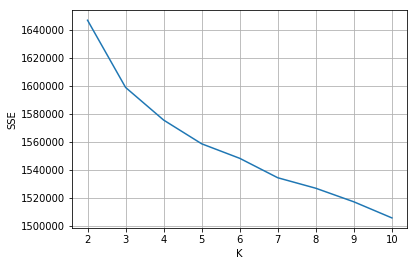

In [0]:
plt.grid()
sns.lineplot(x='K',y='SSE' ,data = sse_df)

In [0]:
km_bow = KMeans(n_clusters = 7 ,n_init = 10 , max_iter = 300)
km_bow.fit(x_bigram_counts)


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [0]:
km_predict = km_bow.predict(x_bigram_counts)

In [0]:
km_predict.shape

(50000,)

In [0]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
index_6 = []
index_7 = []

for i in range(len(km_predict)):
    if km_predict[i] == 0:
        index_1.append(i)
    if km_predict[i] == 1:
        index_2.append(i)
    if km_predict[i] == 2:
        index_3.append(i)
    if km_predict[i] == 3:
        index_4.append(i)
    if km_predict[i] == 4:
        index_5.append(i)
    if km_predict[i] == 5:
        index_6.append(i)
    if km_predict[i] == 6:
        index_7.append(i)
 


###  Wordclouds of clusters obtained after applying k-means on BOW<font color='red'> SET 1</font>

In [0]:
# Please write all the code with proper documentation

text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])

In [0]:
from wordcloud import WordCloud 
from matplotlib.pyplot import figure

words_1 = []

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1.append(text_1[i][j])
        
len(text_1)

10216

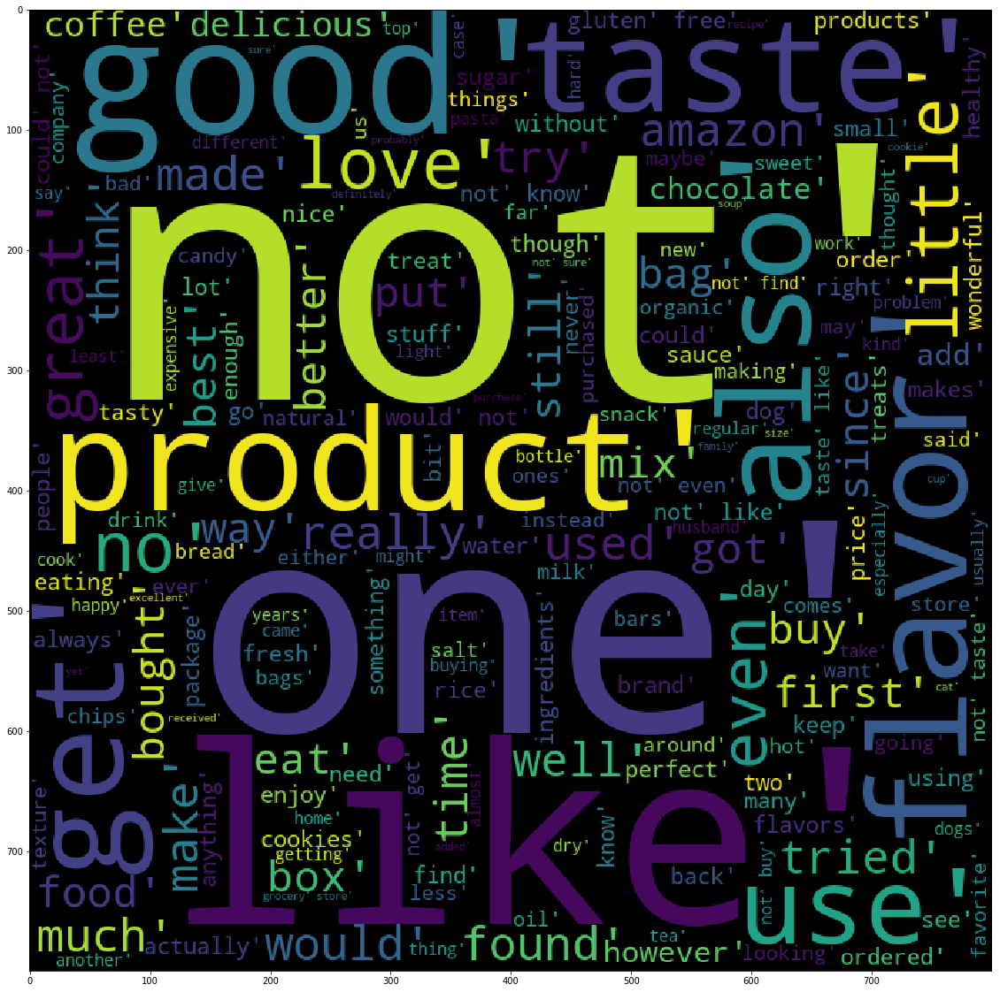

In [0]:
#Initializing WordCloud using frequencies of tags.
wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

434


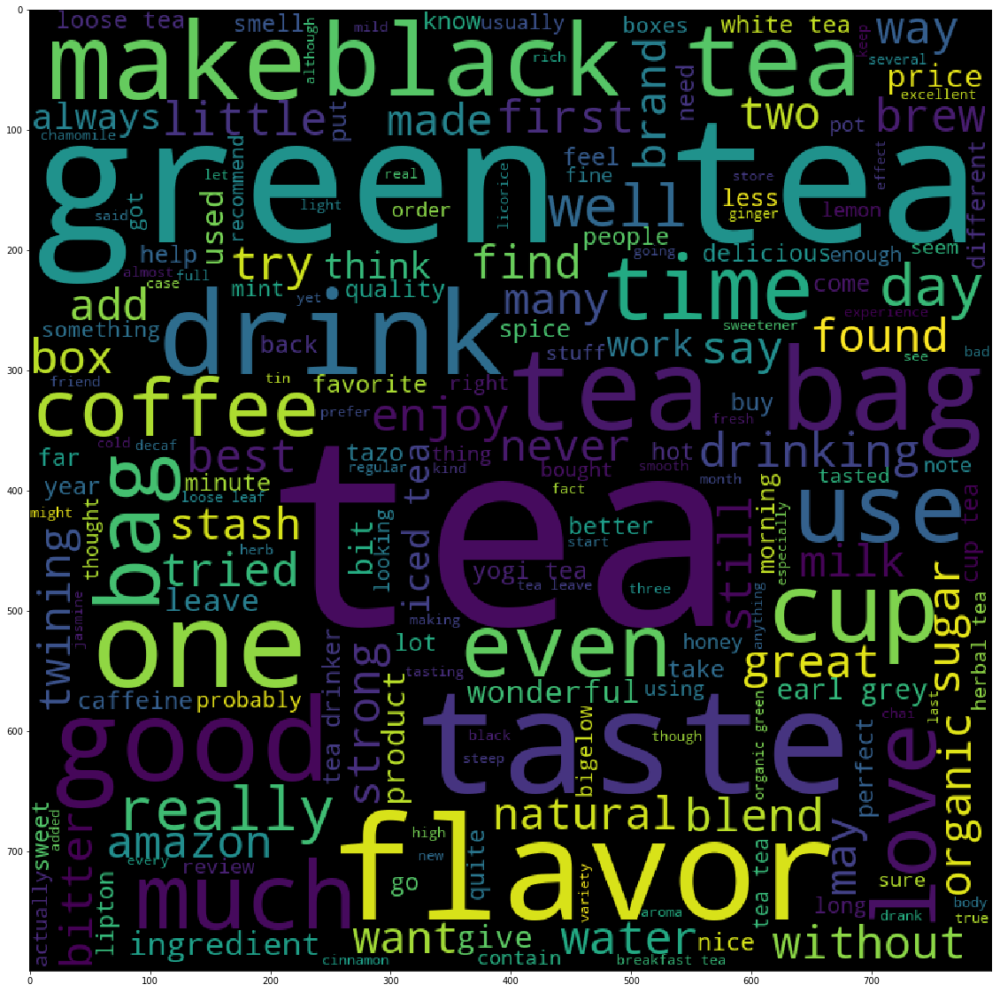

In [0]:
# Please write all the code with proper documentation

text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''

for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '
        
print(len(text_2))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_2))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

8554


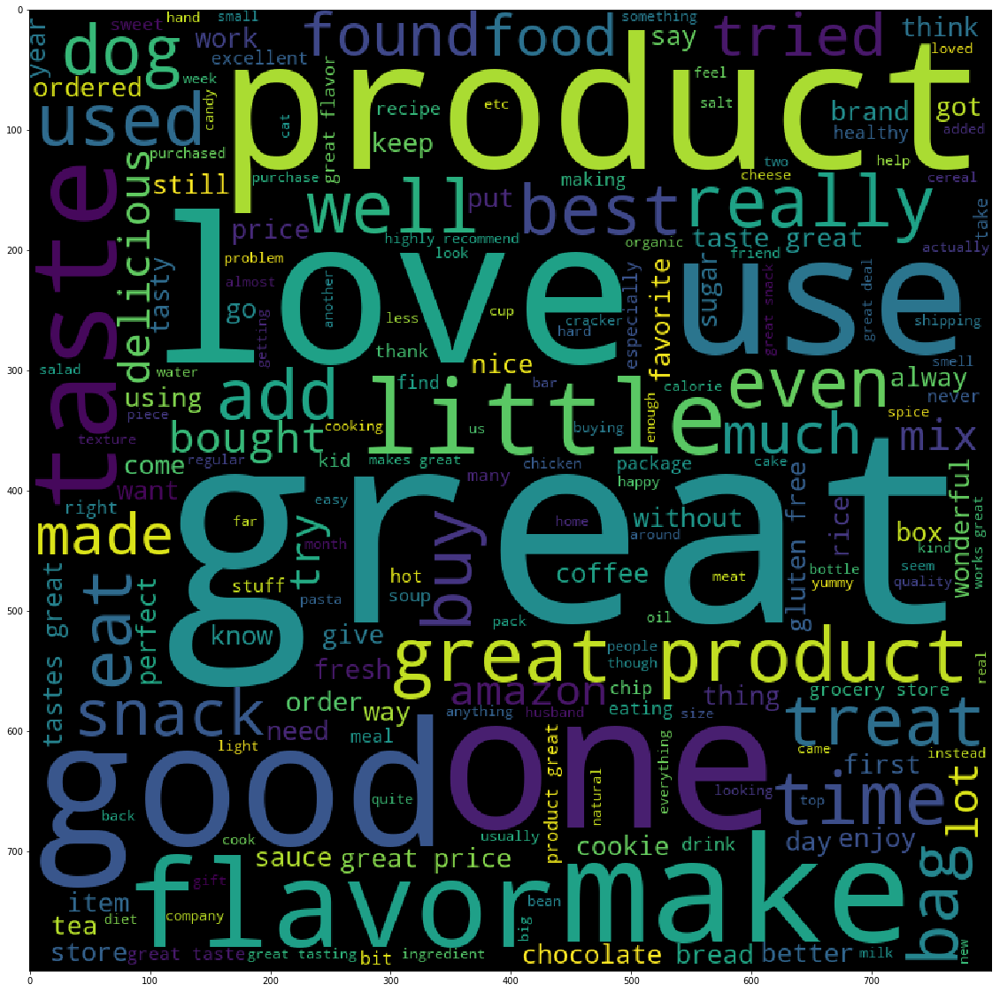

In [0]:
# Please write all the code with proper documentation

text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''

for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '
        
print(len(text_3))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_3))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

3185


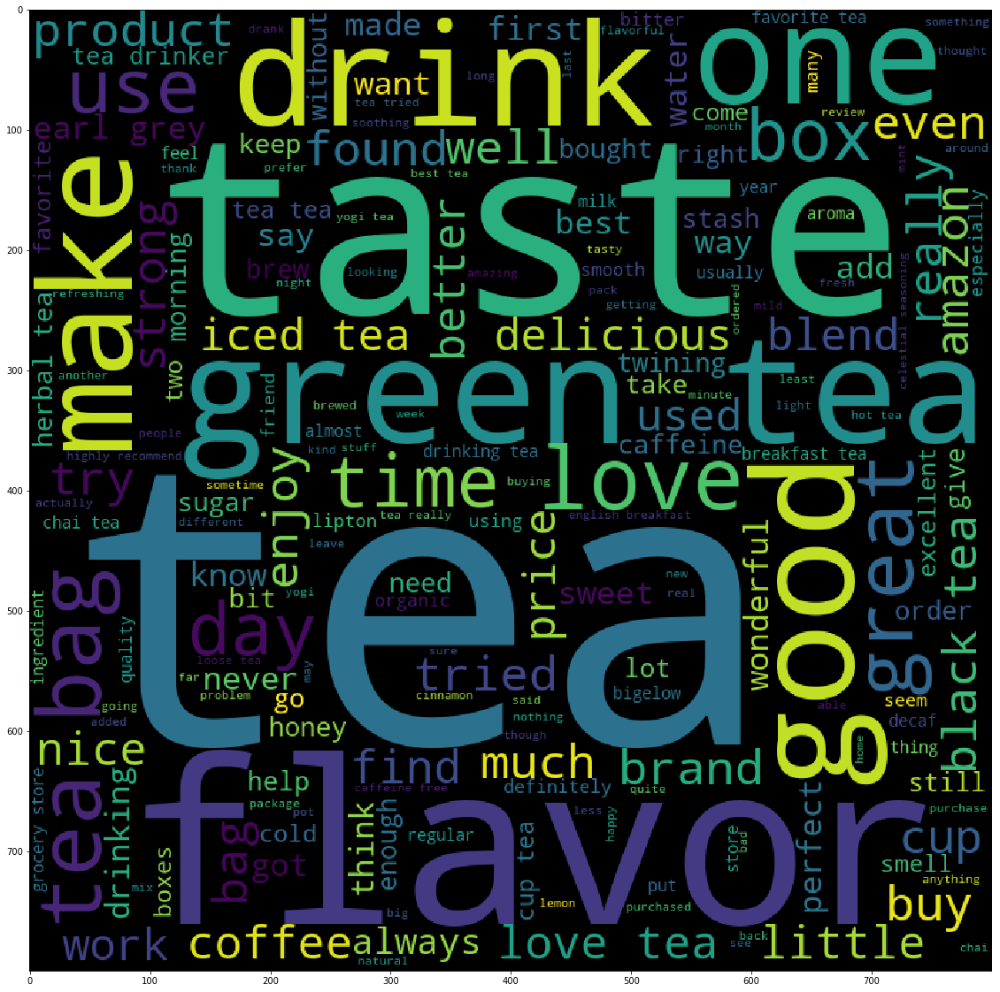

In [0]:
# Please write all the code with proper documentation

text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])
    
words_4 = ''

for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '
        
print(len(text_4))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_4))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

653


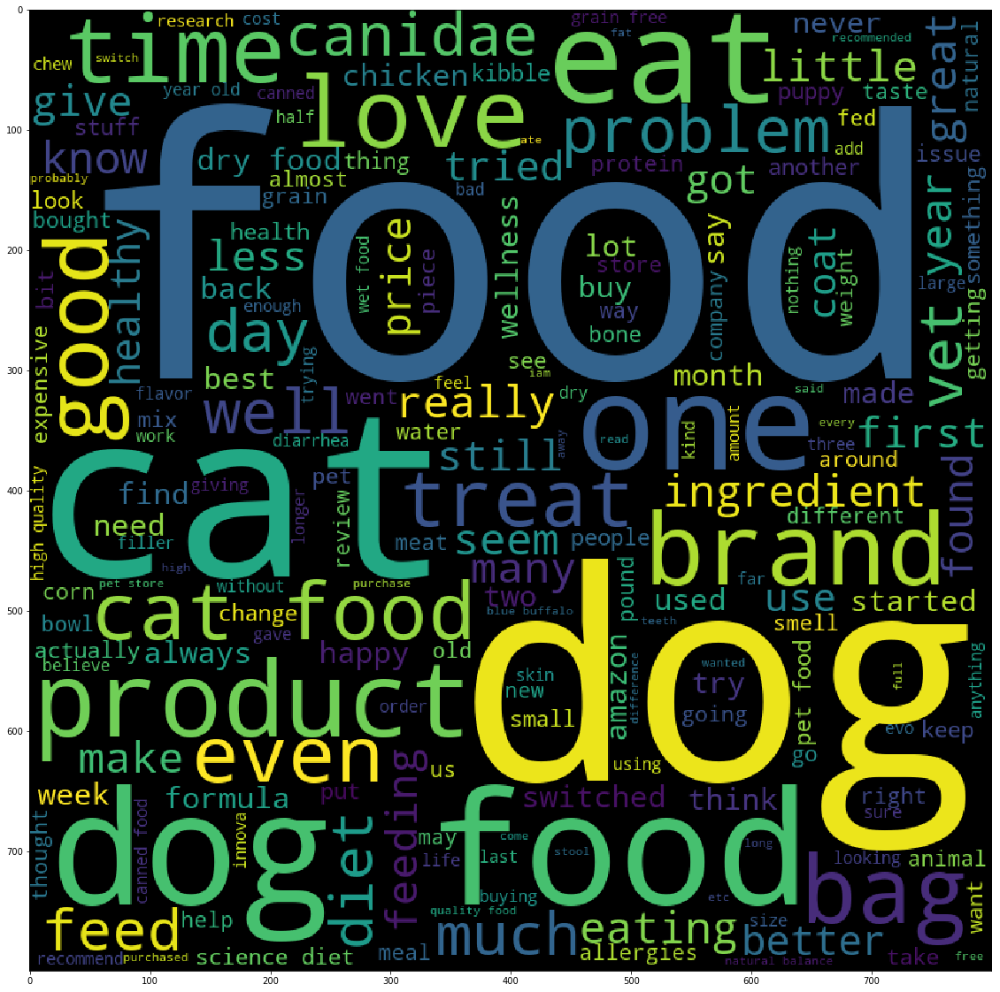

In [0]:
# Please write all the code with proper documentation

text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])
    
words_5 = ''

for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '
        
print(len(text_5))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_5))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

25253


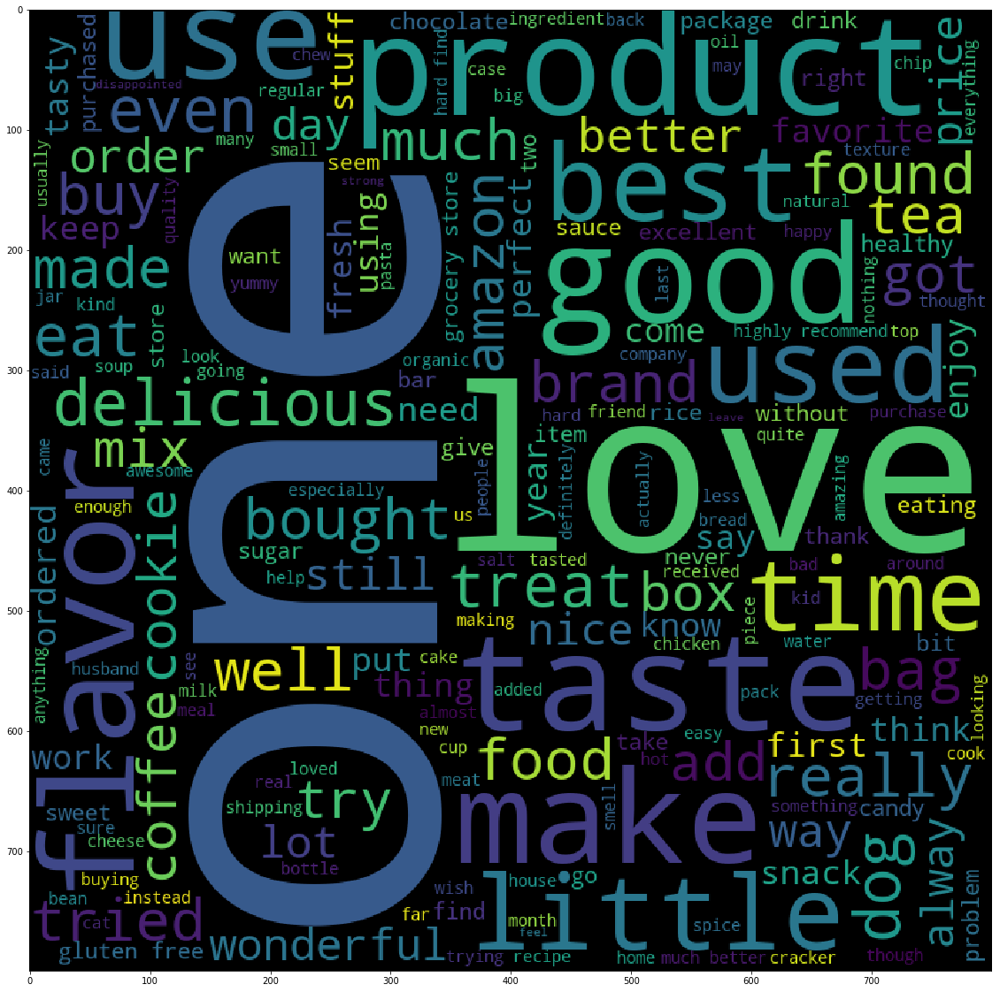

In [0]:
# Please write all the code with proper documentation

text_6 = []
for i in range(len(index_6)):
    text_6.append(list_of_sentance[index_6[i]])
    
words_6 = ''

for i in range(len(text_6)):
    for j in range(len(text_6[i])):
        words_6 = words_6 + text_6[i][j] + ' '
        
print(len(text_6))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_6))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

1705


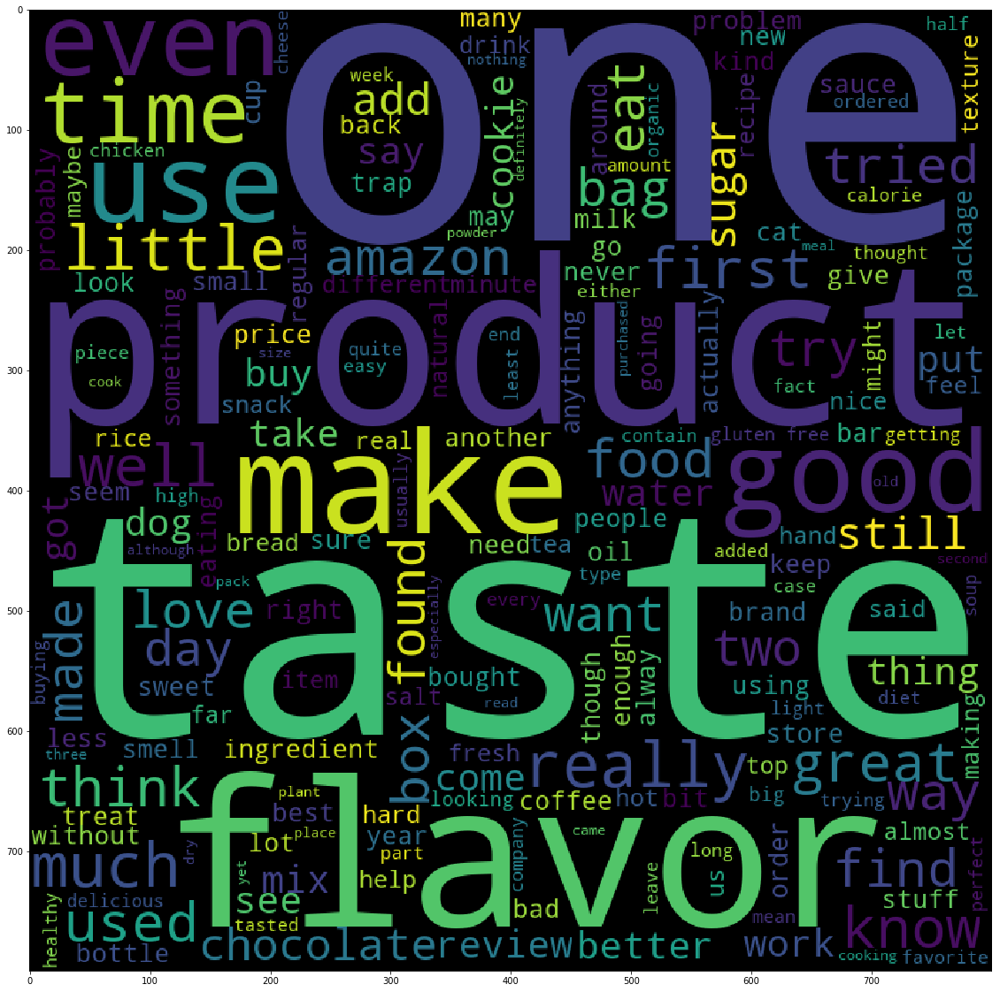

In [0]:
# Please write all the code with proper documentation

text_7 = []
for i in range(len(index_7)):
    text_7.append(list_of_sentance[index_7[i]])
    
words_7 = ''

for i in range(len(text_7)):
    for j in range(len(text_7[i])):
        words_7 = words_7 + text_7[i][j] + ' '
        
print(len(text_7))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_7))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

###  Applying K-Means Clustering on TFIDF,<font color='red'> SET 2</font>

In [0]:
# Please write all the code with proper documentation

# Please write all the code with proper documentation

from sklearn.cluster import KMeans

sse_df_tfidf = pd.DataFrame(columns = ['K', 'SSE'])

for i in range(2,11):
    
    km = KMeans(n_clusters = i ,n_init = 10 , max_iter = 300)
    km.fit(x_tf_idf)
    sse_df_tfidf.loc[sse_df_tfidf.shape[0]] = [i ,km.inertia_]

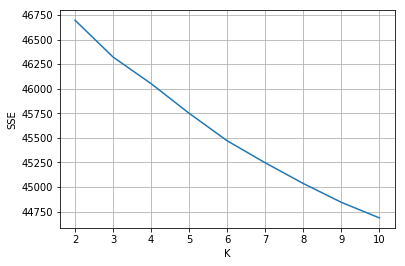

In [0]:
plt.grid()
sns.lineplot(x='K',y='SSE' ,data = sse_df_tfidf)

In [0]:
km_tfidf = KMeans(n_clusters = 6 ,n_init = 10 , max_iter = 300)
km_tfidf.fit(x_tf_idf)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [0]:
    km_tfidf_pred = km_tfidf.predict(x_tf_idf)

In [0]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
index_6 = []
index_7 = []

for i in range(len(km_tfidf_pred)):
    if km_tfidf_pred[i] == 0:
        index_1.append(i)
    if km_tfidf_pred[i] == 1:
        index_2.append(i)
    if km_tfidf_pred[i] == 2:
        index_3.append(i)
    if km_tfidf_pred[i] == 3:
        index_4.append(i)
    if km_tfidf_pred[i] == 4:
        index_5.append(i)
    if km_tfidf_pred[i] == 5:
        index_6.append(i)
    if km_tfidf_pred[i] == 6:
        index_7.append(i)
 


4861


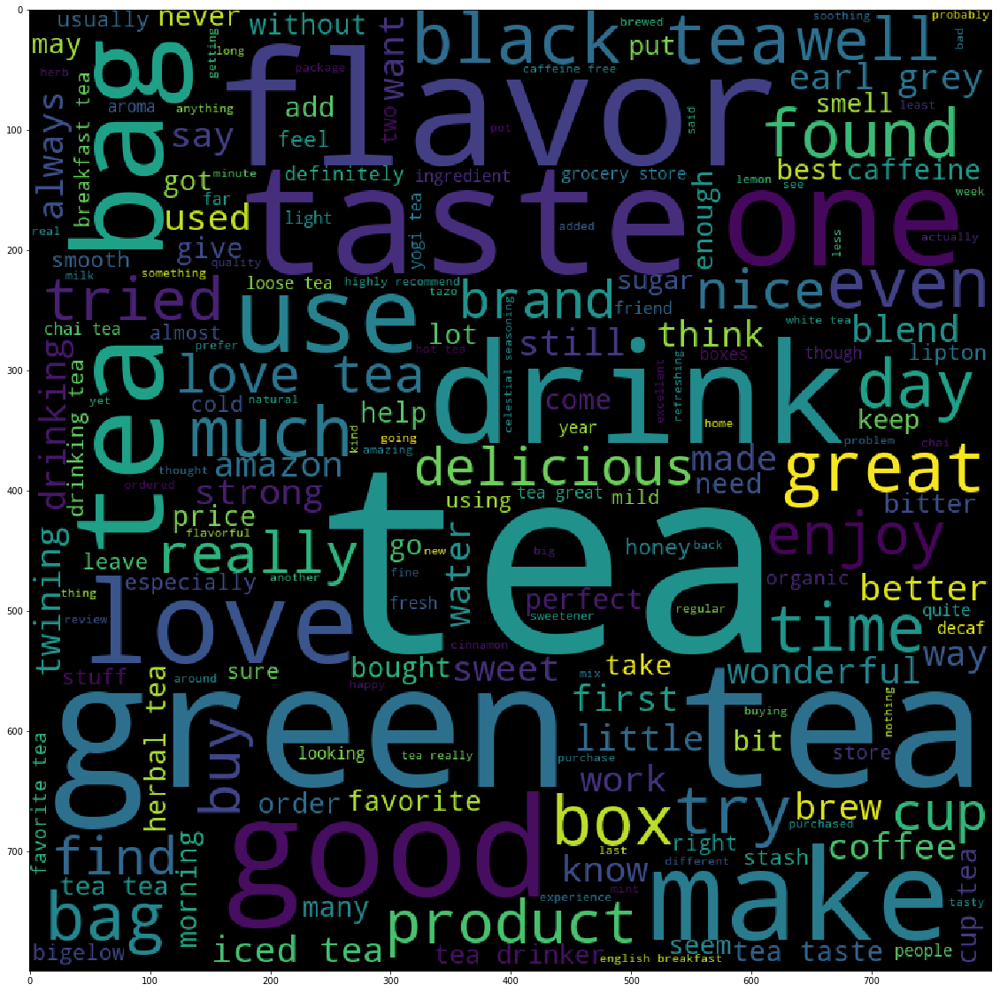

In [0]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '
        
print(len(text_1))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

###  Wordclouds of clusters obtained after applying k-means on TFIDF<font color='red'> SET 2</font>

10264


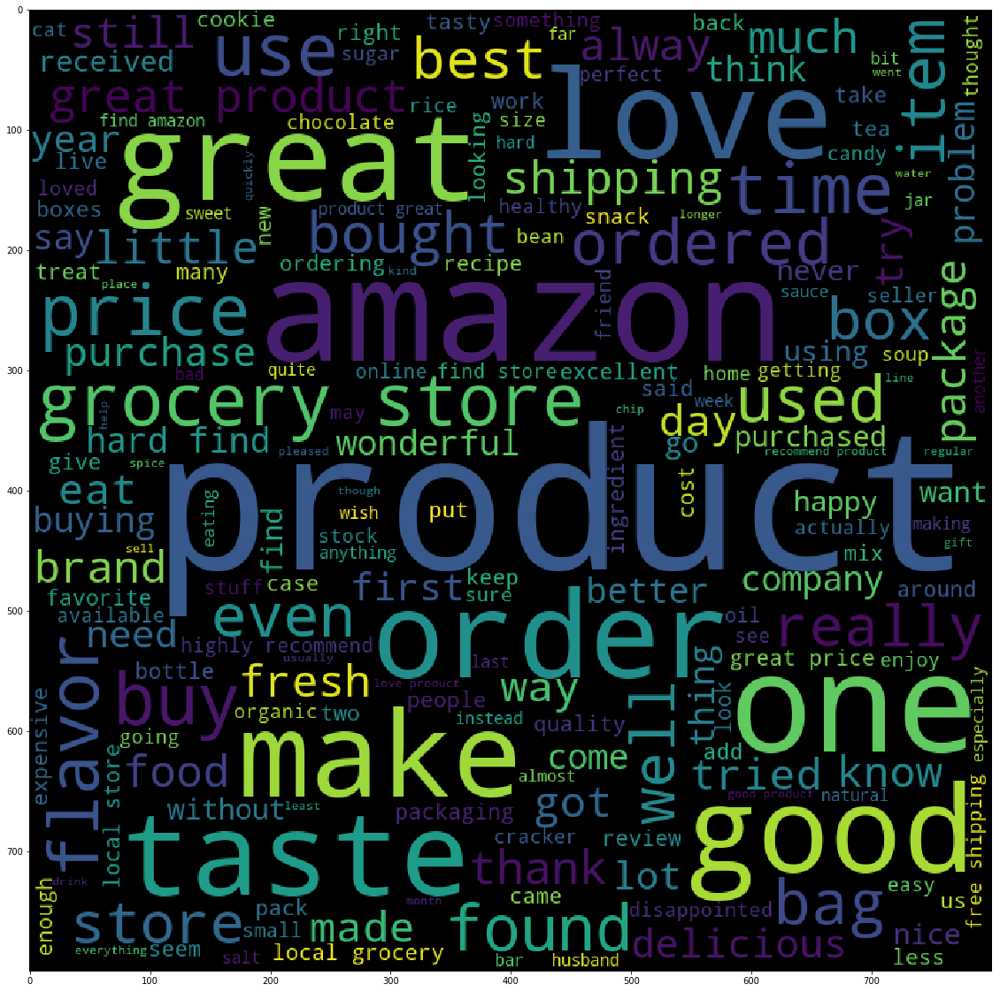

In [0]:
# Please write all the code with proper documentation

# Please write all the code with proper documentation
from wordcloud import WordCloud
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''

for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '
        
print(len(text_2))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_2))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

2094


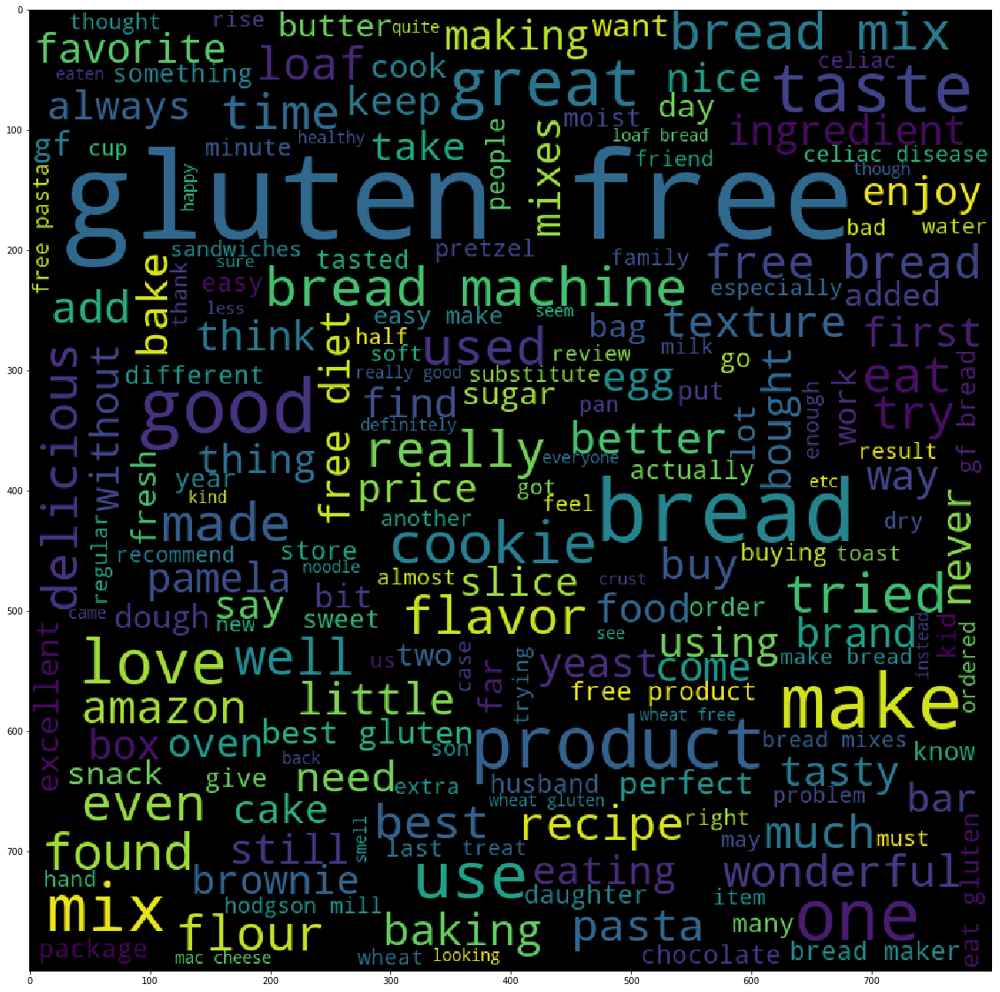

In [0]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''

for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '
        
print(len(text_3))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_3))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

1676


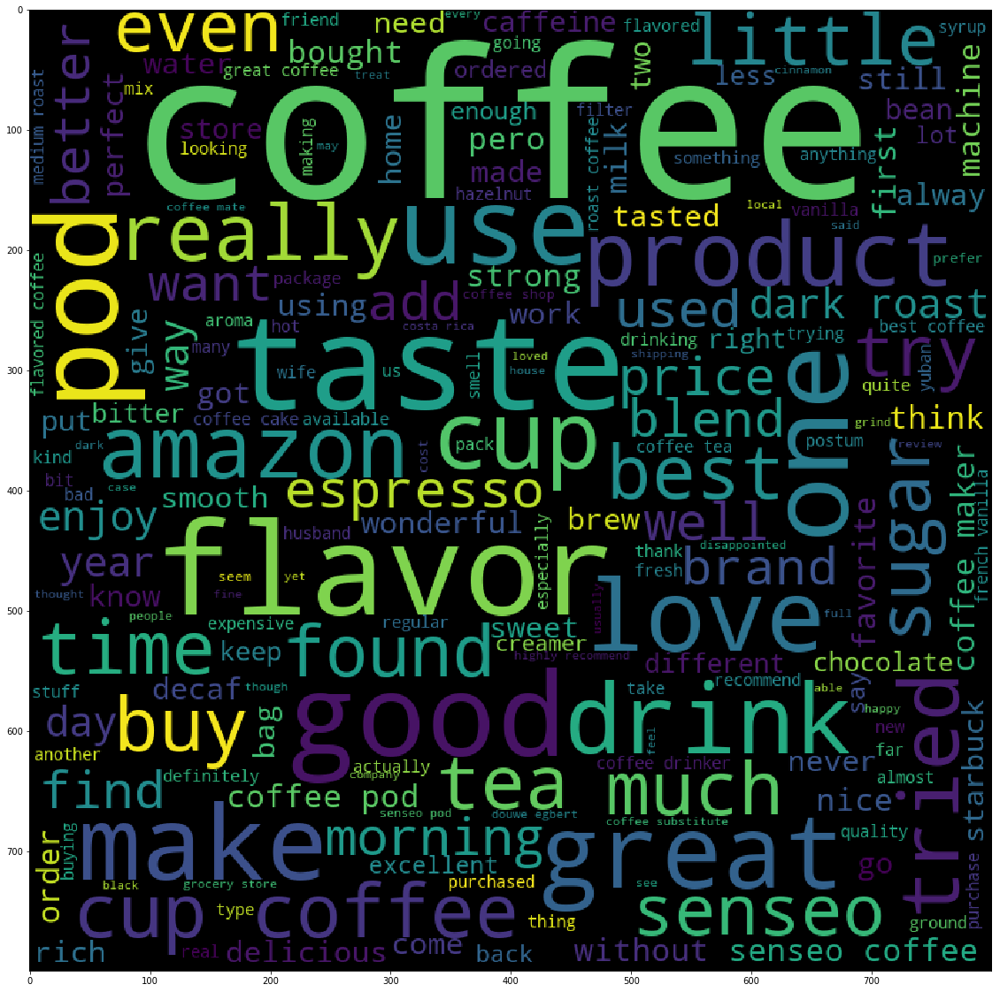

In [0]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])
    
words_4 = ''

for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '
        
print(len(text_4))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_4))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

3725


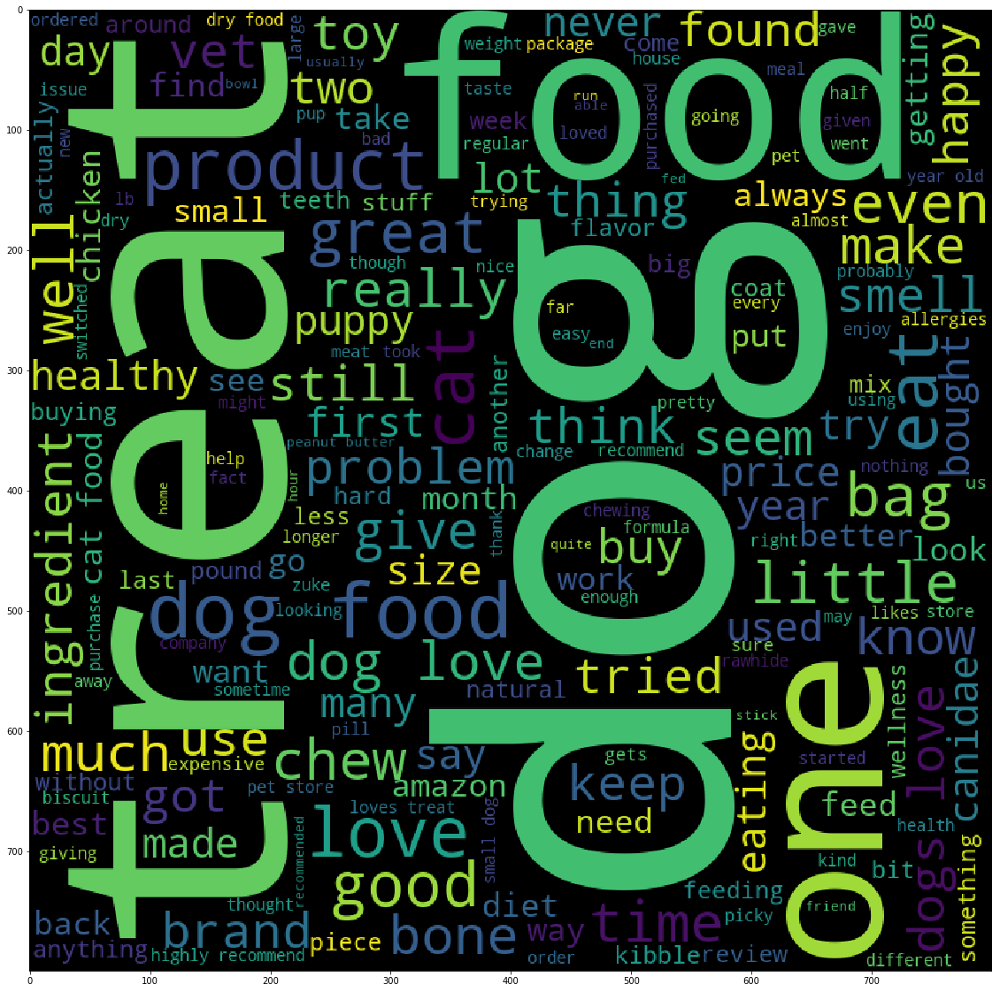

In [0]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])
    
words_5 = ''

for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '
        
print(len(text_5))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_5))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

27380


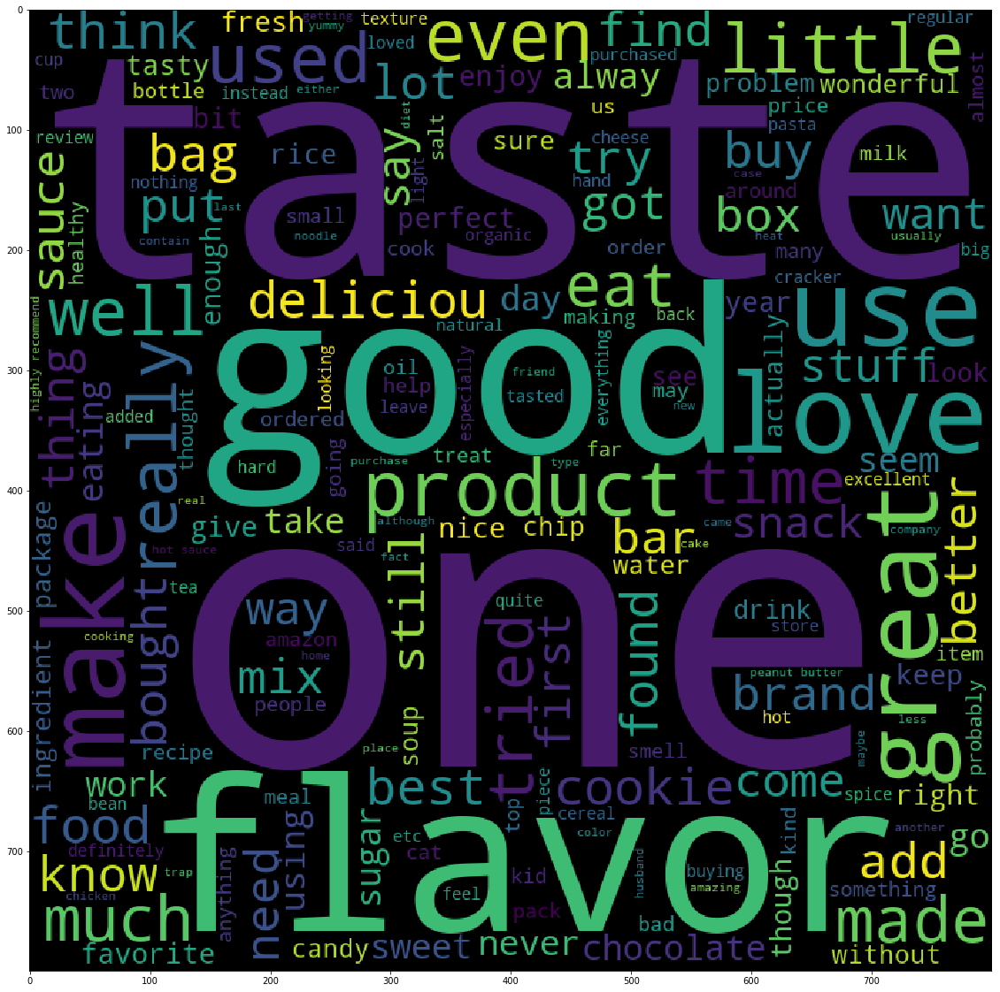

In [0]:
# Please write all the code with proper documentation
text_6 = []
for i in range(len(index_6)):
    text_6.append(list_of_sentance[index_6[i]])
    
words_6 = ''

for i in range(len(text_6)):
    for j in range(len(text_6[i])):
        words_6 = words_6 + text_6[i][j] + ' '
        
print(len(text_6))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_6))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

###  Applying K-Means Clustering on AVG W2V,<font color='red'> SET 3</font>

In [0]:
sse_df_avgw2v = pd.DataFrame(columns = ["K","SSE"])

for i in range(2,11):
    km_avgw2v = KMeans(n_clusters = i ,n_init = 10 ,max_iter = 300)
    km_avgw2v.fit(sent_vectors)
    sse_df_avgw2v.loc[sse_df_avgw2v.shape[0]] = [i , km_avgw2v.inertia_]

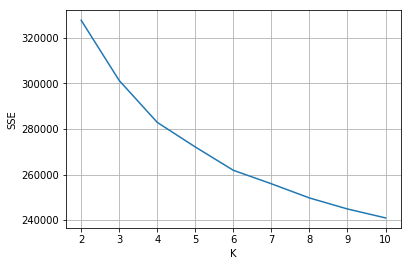

In [0]:
plt.grid()
sns.lineplot(x='K',y='SSE' ,data = sse_df_avgw2v)

In [0]:
# Please write all the code with proper documentation

km_avgw2v = KMeans(n_clusters = 6 ,n_init = 10 ,max_iter = 300)
km_avgw2v.fit(sent_vectors)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [0]:
km_avgw2v_pred = km_avgw2v.predict(sent_vectors)

In [0]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
index_6 = []

for i in range(len(km_avgw2v_pred)):
    if km_avgw2v_pred[i] == 0:
        index_1.append(i)
    if km_avgw2v_pred[i] == 1:
        index_2.append(i)
    if km_avgw2v_pred[i] == 2:
        index_3.append(i)
    if km_avgw2v_pred[i] == 3:
        index_4.append(i)
    if km_avgw2v_pred[i] == 4:
        index_5.append(i)
    if km_avgw2v_pred[i] == 5:
        index_6.append(i)

 


###  Wordclouds of clusters obtained after applying k-means on AVG W2V<font color='red'> SET 3</font>

9348


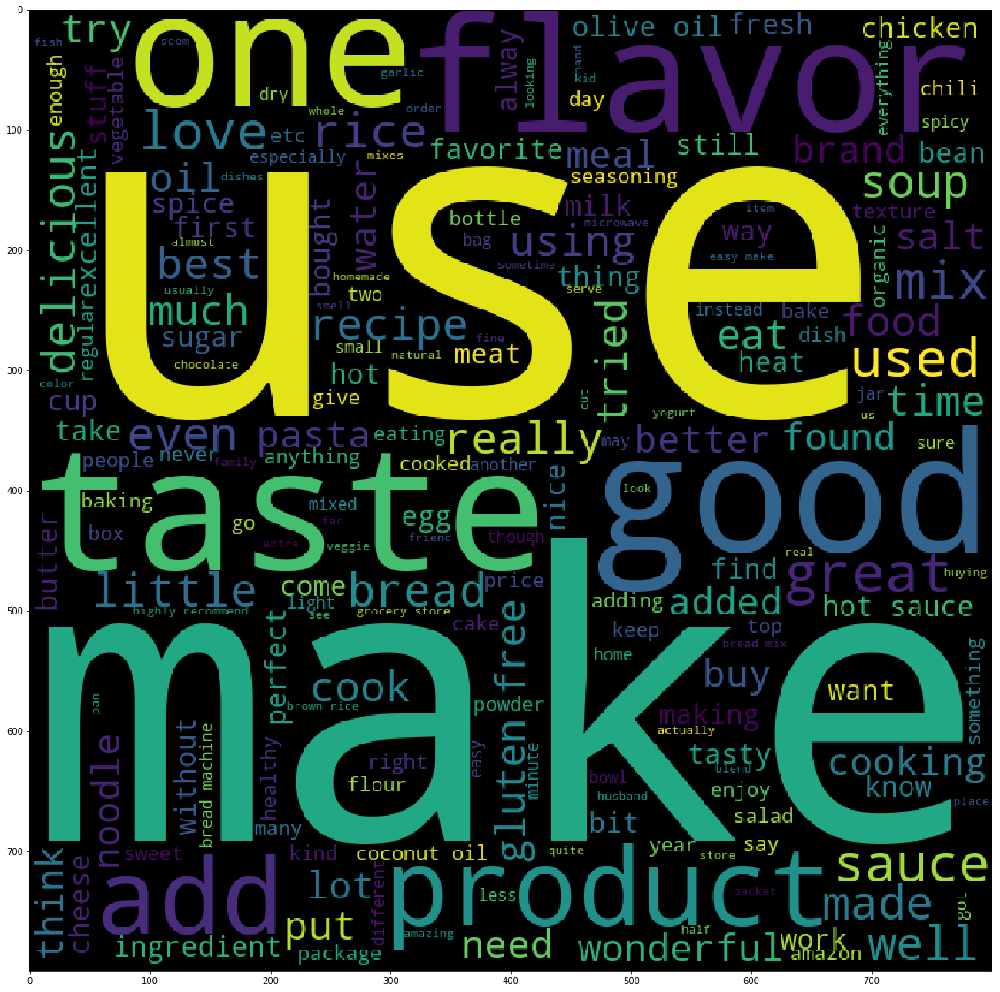

In [0]:
# Please write all the code with proper documentation

# Please write all the code with proper documentation
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '
        
print(len(text_1))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

6139


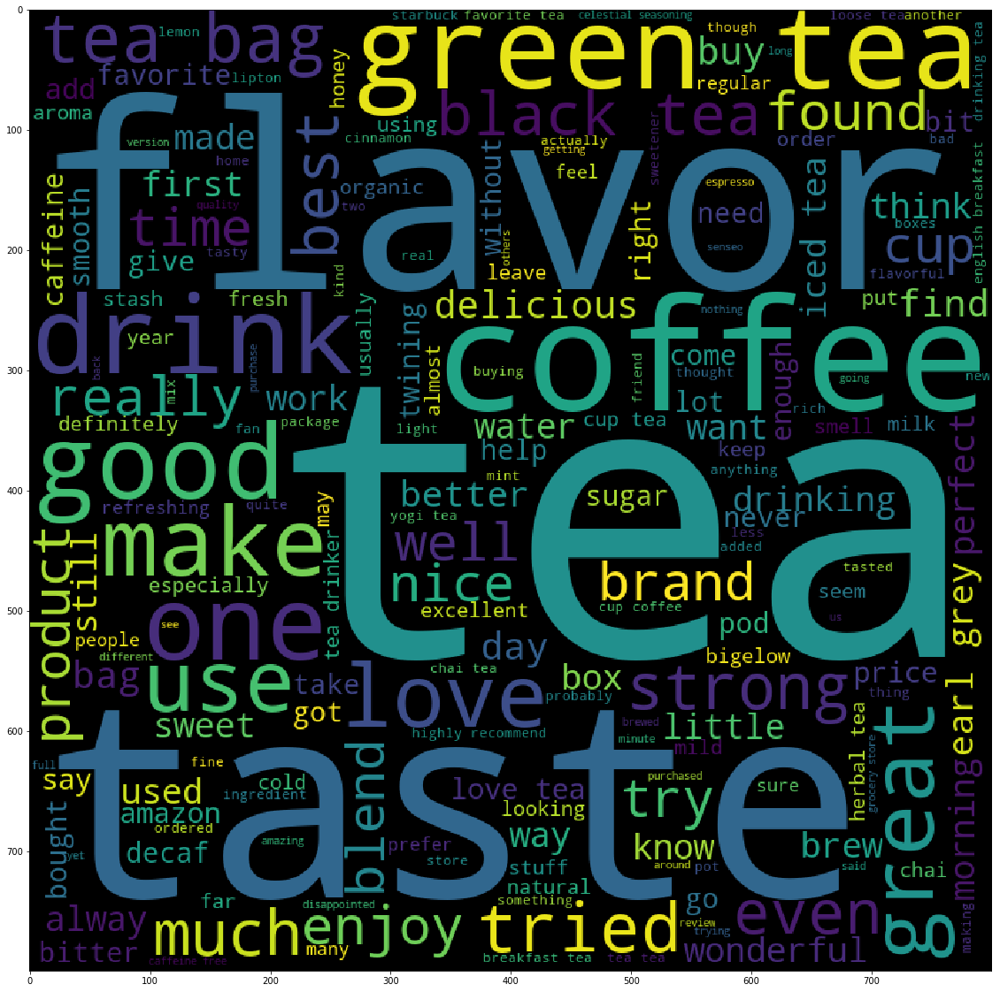

In [0]:
# Please write all the code with proper documentation
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''

for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '
        
print(len(text_2))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_2))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

6574


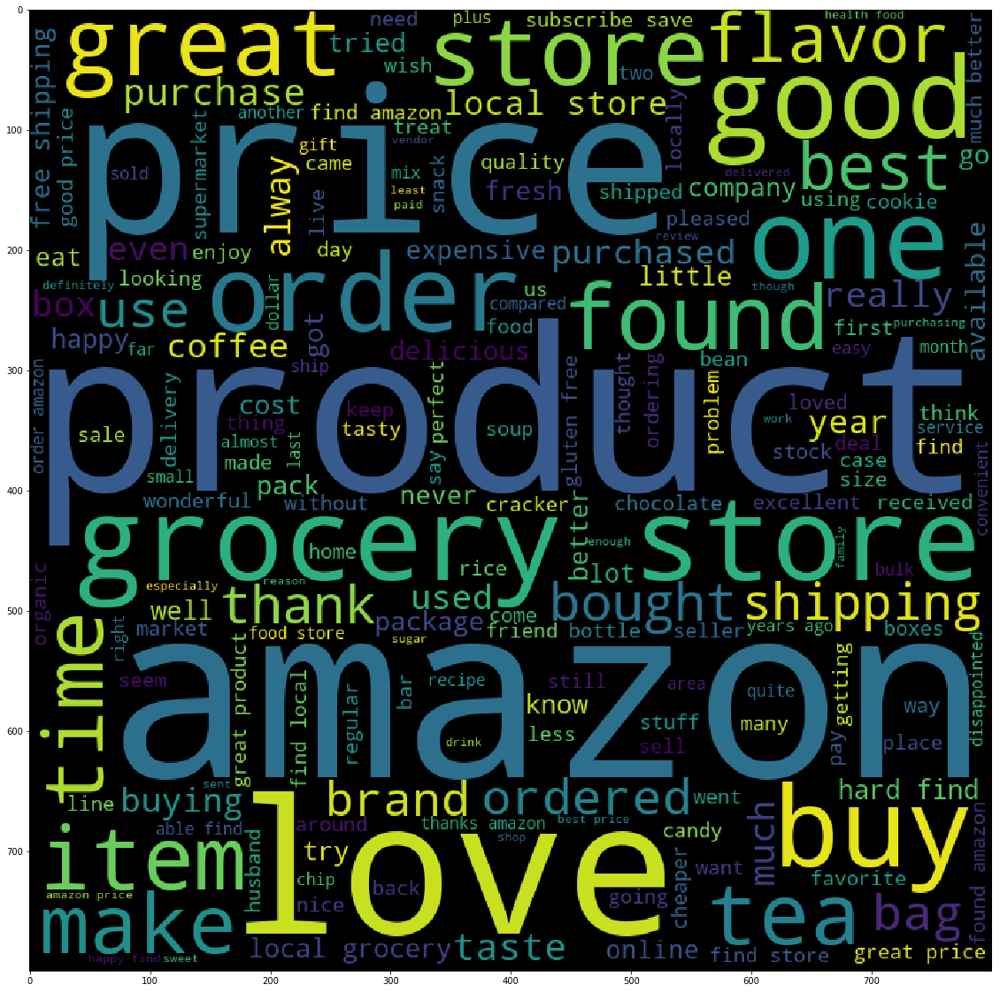

In [0]:
# Please write all the code with proper documentation
text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''

for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '
        
print(len(text_3))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_3))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

11746


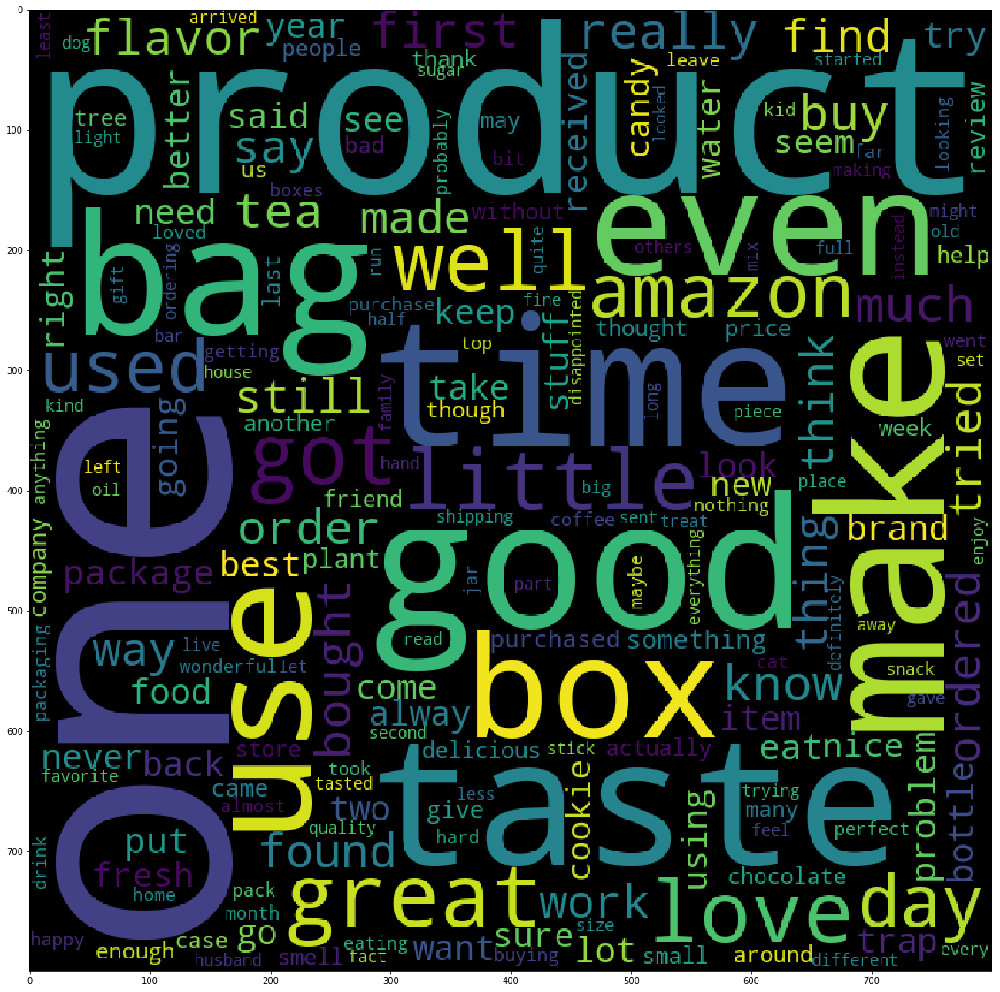

In [0]:
# Please write all the code with proper documentation
text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])
    
words_4 = ''

for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '
        
print(len(text_4))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_4))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

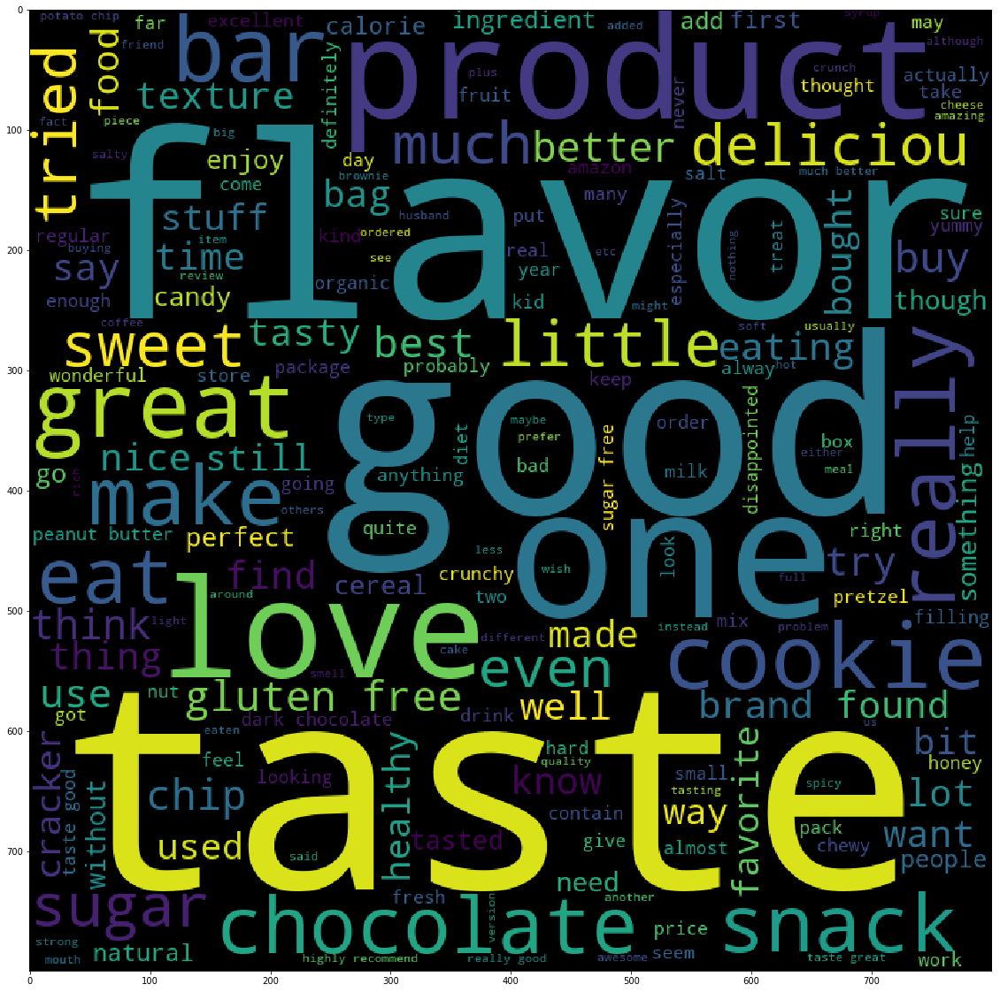

In [0]:
# Please write all the code with proper documentation
text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])
    
words_5 = ''

for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '
        
print(len(text_5))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_5))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

5435


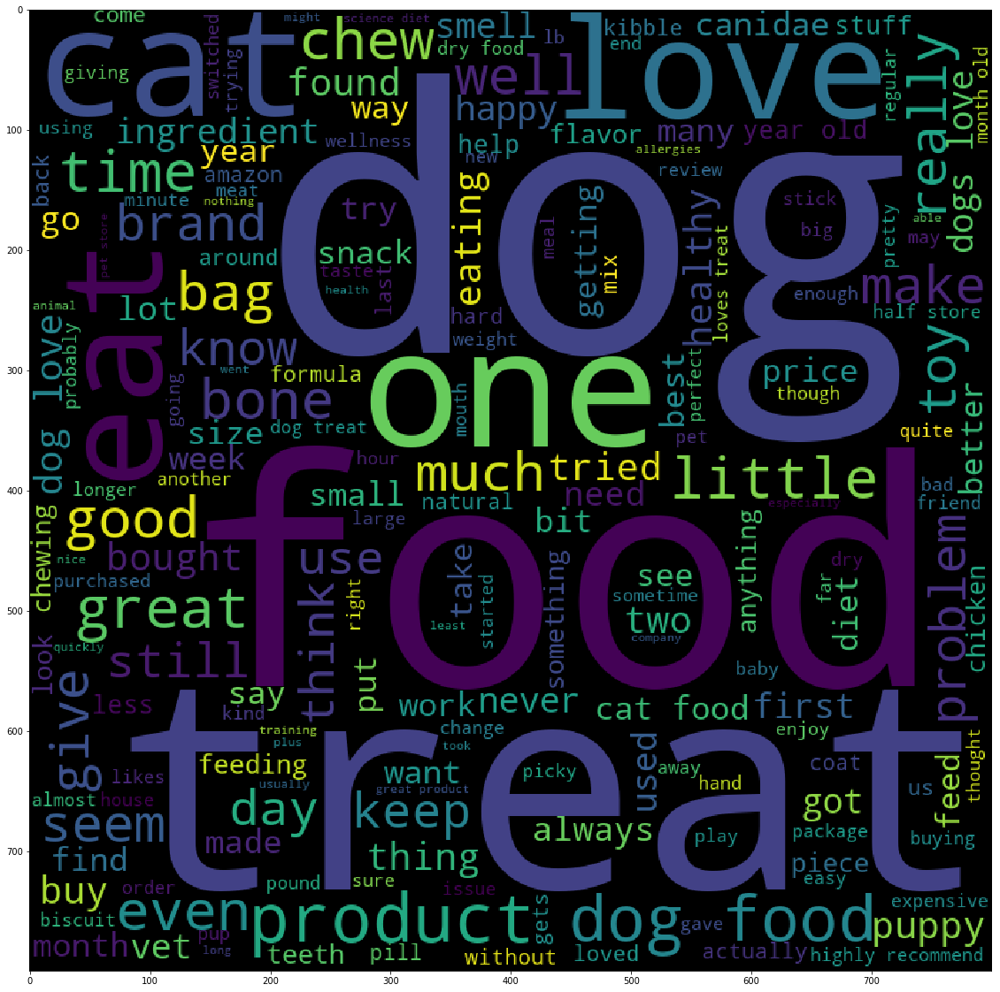

In [0]:
# Please write all the code with proper documentation
text_6 = []
for i in range(len(index_6)):
    text_6.append(list_of_sentance[index_6[i]])
    
words_6 = ''

for i in range(len(text_6)):
    for j in range(len(text_6[i])):
        words_6 = words_6 + text_6[i][j] + ' '
        
print(len(text_6))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_6))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

### Applying K-Means Clustering on TFIDF W2V,<font color='red'> SET 4</font>

In [0]:
# Please write all the code with proper documentation

from sklearn.cluster import KMeans
sse_df_tfidfw2v = pd.DataFrame(columns = ['K','SSE'])

for i in range(2 ,11):
    km_tfidfw2v = KMeans(n_clusters = i ,n_init = 10 ,max_iter = 300)
    km_tfidfw2v.fit(tfidf_sent_vectors)
    sse_df_tfidfw2v.loc[sse_df_tfidfw2v.shape[0]] = [i ,km_tfidfw2v.inertia_]

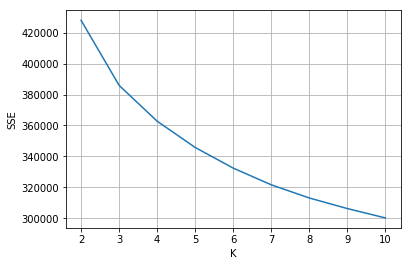

In [0]:
plt.grid()
sns.lineplot(x = 'K' ,y = 'SSE' ,data = sse_df_tfidfw2v )

In [0]:
km_tfidfw2v = KMeans(n_clusters = 3 ,n_init = 10 ,max_iter = 300)

km_tfidfw2v.fit(tfidf_sent_vectors)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [0]:
km_tfidfw2v_predict = km_tfidfw2v.predict(tfidf_sent_vectors)

In [0]:
index_1 = []
index_2 = []
index_3 = []

for i in range(len(km_tfidfw2v_predict)):
    if km_tfidfw2v_predict[i] == 0:
        index_1.append(i)
    if km_tfidfw2v_predict[i] == 1:
        index_2.append(i)
    if km_tfidfw2v_predict[i] == 2:
        index_3.append(i)
 


### [5.1.8] Wordclouds of clusters obtained after applying k-means on TFIDF W2V<font color='red'> SET 4</font>

21256


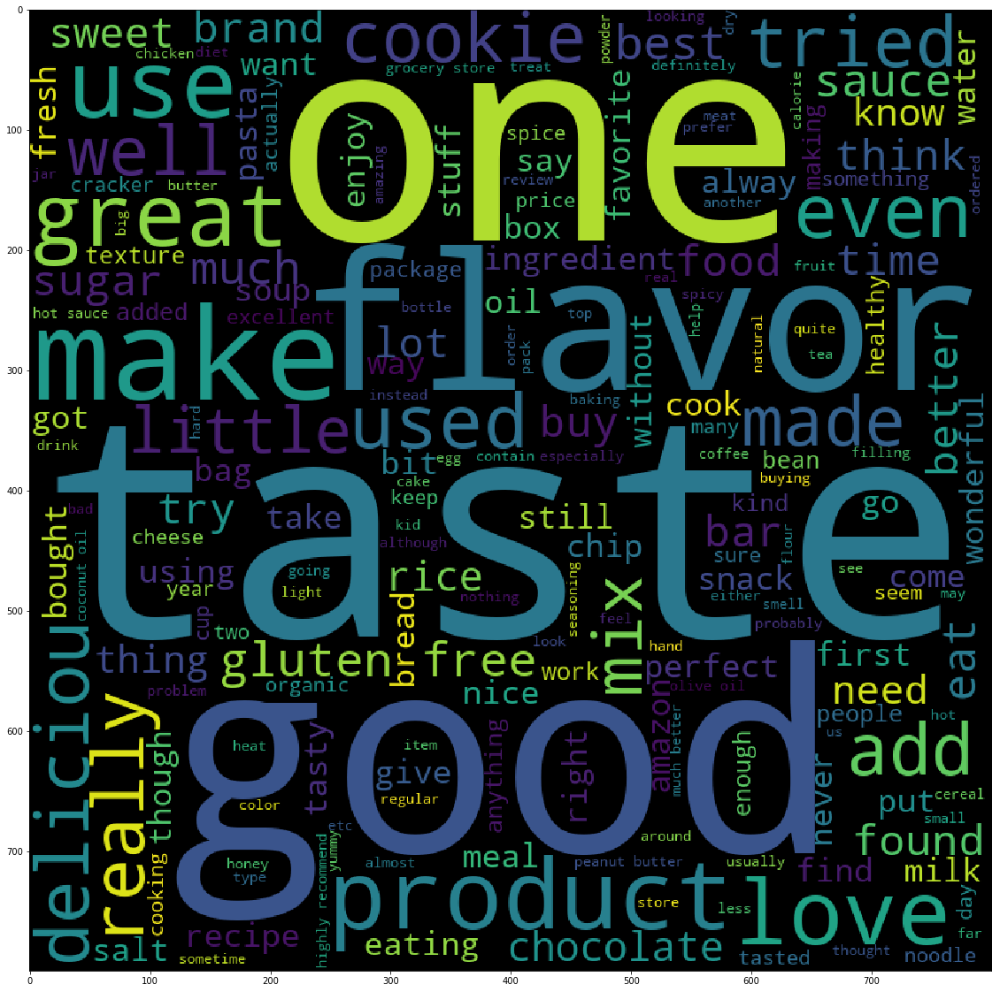

In [0]:
# Please write all the code with proper documentation

# Please write all the code with proper documentation
from wordcloud import WordCloud
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '
        
print(len(text_1))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

5943


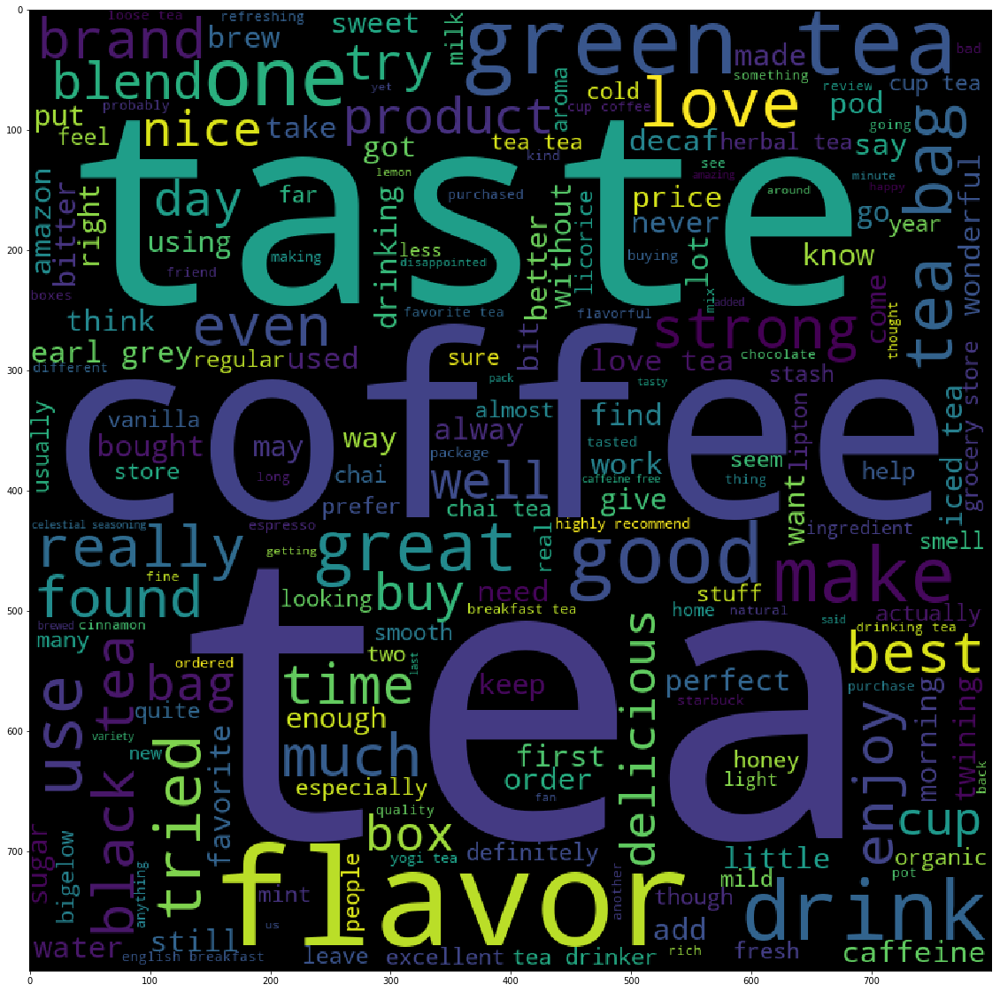

In [0]:

text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''

for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '
        
print(len(text_2))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_2))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

22801


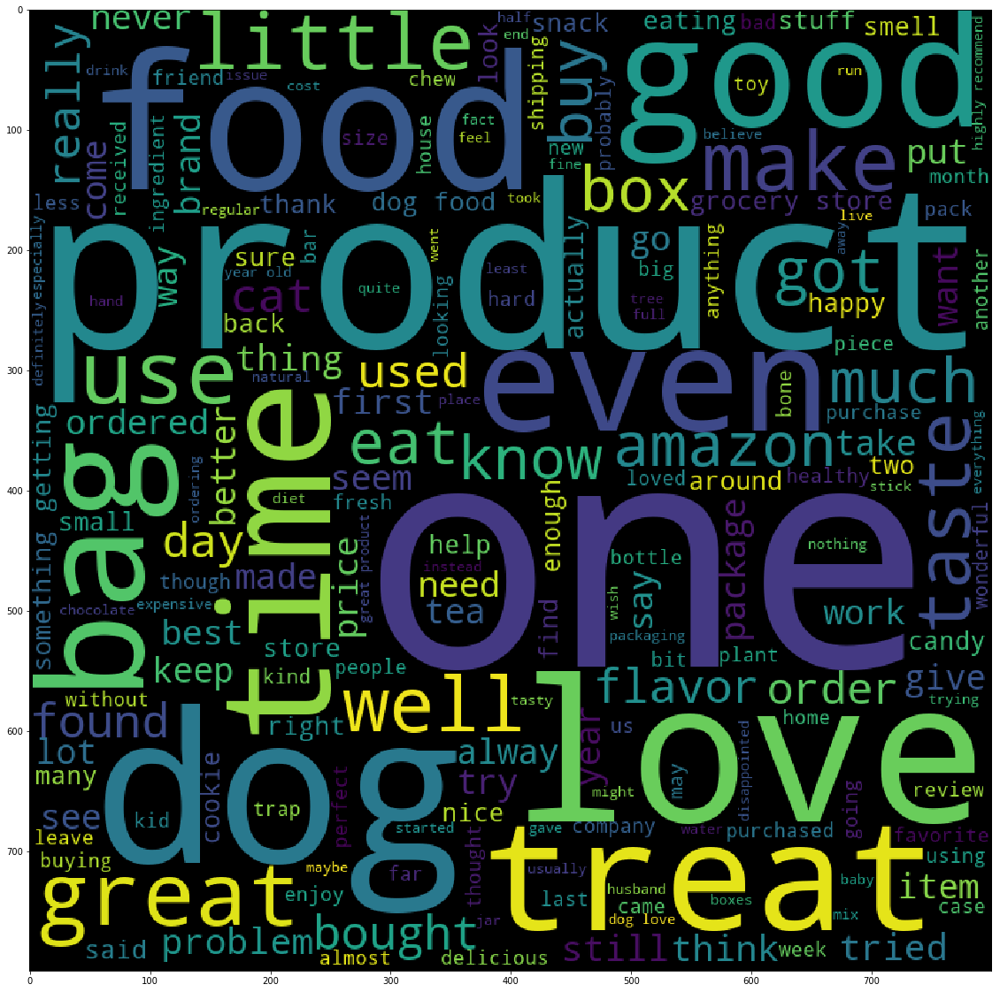

In [0]:
text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''
 
for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '

print(len(text_3))

wordcloud = WordCloud( background_color = 'black',
                     width = 800,
                     height = 800
                     ).generate(str(words_3))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

## [5.2] Agglomerative Clustering

In [31]:
X = X[:5000]
Y = Y[:5000]

In [32]:
# Train your own Word2Vec model using your own text corpus
i=0
list_of_sentance=[]
for sentance in X:
    list_of_sentance.append(sentance.split())
    
    

# min_count = 5 considers only words that occured atleast 5 times
w2v_model=Word2Vec(list_of_sentance,min_count=5,size=50, workers=4)
print(w2v_model.wv.most_similar('great'))
print('='*50)
print(w2v_model.wv.most_similar('worst'))


w2v_words = list(w2v_model.wv.vocab)
print("number of words that occured minimum 5 times ",len(w2v_words))
print("sample words ", w2v_words[0:50])


# average Word2Vec
# compute average word2vec for each review.
sent_vectors = []; # the avg-w2v for each sentence/review is stored in this list
for sent in tqdm(list_of_sentance): # for each review/sentence
    sent_vec = np.zeros(50) # as word vectors are of zero length 50, you might need to change this to 300 if you use google's w2v
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
print(len(sent_vectors[0]))

[('good', 0.993822455406189), ('quality', 0.9932513236999512), ('tastes', 0.9898638725280762), ('definitely', 0.9877063035964966), ('much', 0.9862600564956665), ('really', 0.9856681823730469), ('also', 0.9852777719497681), ('sweet', 0.9852546453475952), ('makes', 0.9846981763839722), ('stuff', 0.9845888614654541)]
[('heard', 0.9997313022613525), ('stop', 0.9997197389602661), ('table', 0.9996947050094604), ('system', 0.9996928572654724), ('seriously', 0.9996896982192993), ('young', 0.9996870756149292), ('major', 0.9996774792671204), ('country', 0.999669075012207), ('gold', 0.9996627569198608), ('switch', 0.9996617436408997)]
number of words that occured minimum 5 times  4774
sample words  ['set', 'aside', 'least', 'hour', 'day', 'read', 'son', 'point', 'consider', 'connoisseur', 'children', 'books', 'one', 'best', 'santa', 'put', 'tree', 'since', 'loves', 'first', 'book', 'taught', 'months', 'year', 'second', 'pleasure', 'well', 'suited', 'old', 'worth', 'library', 'however', 'deserves'

100%|█████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:09<00:00, 518.39it/s]


5000
50


In [33]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
model = TfidfVectorizer()
tf_idf_matrix = model.fit_transform(X)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model.get_feature_names(), list(model.idf_)))


# TF-IDF weighted Word2Vec
tfidf_feat = model.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in tqdm(list_of_sentance): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words and word in tfidf_feat:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

100%|█████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:47<00:00, 105.31it/s]


### [5.2.1] Applying Agglomerative Clustering on AVG W2V,<font color='red'> SET 3</font>

In [0]:
# Please write all the code with proper documentation
acc_w2v_2 = AgglomerativeClustering(n_clusters = 2)
acc_w2v_2_pred = acc_w2v_2.fit_predict(sent_vectors)

In [0]:
index_1 = []
index_2 = []

for i in range(len(acc_w2v_2_pred)):
    if acc_w2v_2_pred[i] == 0:
        index_1.append(i)
    if acc_w2v_2_pred[i] == 1:
        index_2.append(i)

### [5.2.2] Wordclouds of clusters obtained after applying Agglomerative Clustering on AVG W2V<font color='red'> SET 3</font>

719773


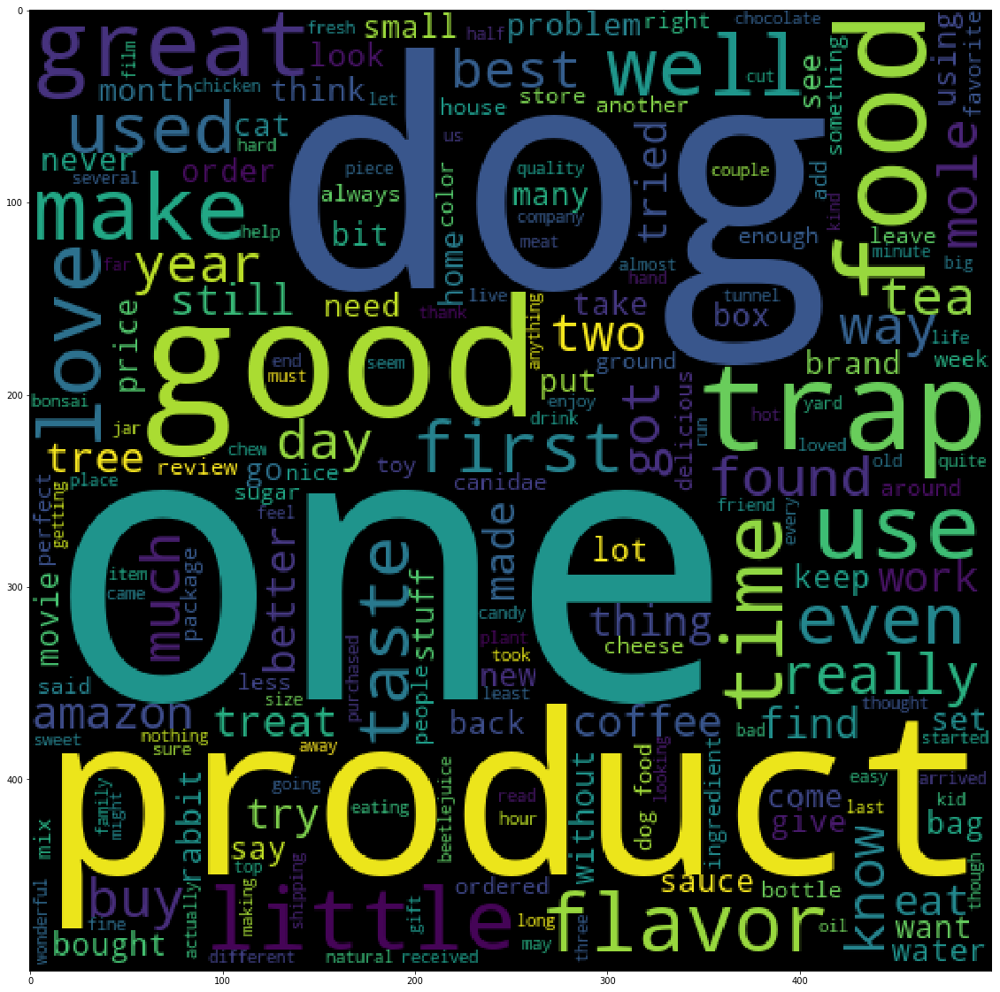

In [0]:
# Please write all the code with proper documentation
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])

words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

658278


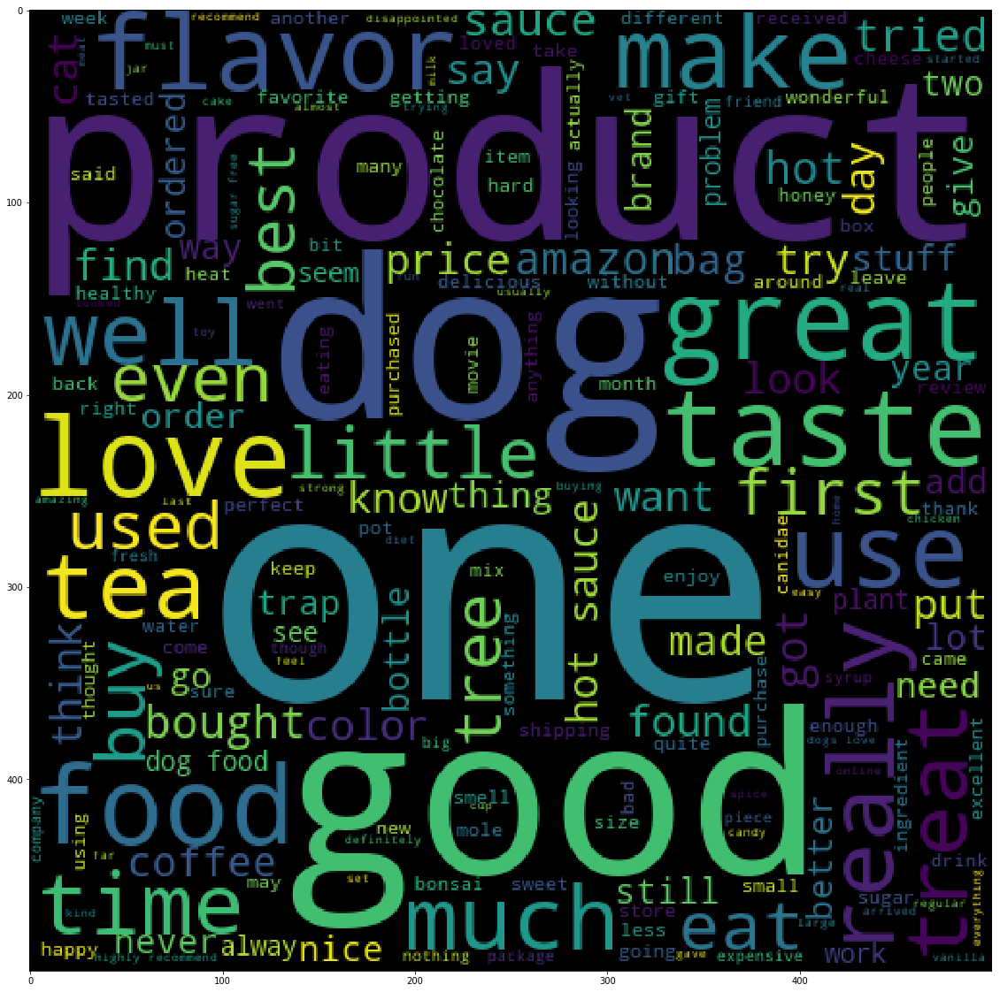

In [0]:
# Please write all the code with proper documentation
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])

words_2 = ''
for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '

print(len(words_2))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_2))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

In [0]:
# Please write all the code with proper documentation
acc_w2v_5 = AgglomerativeClustering(n_clusters = 5)
acc_w2v_5_pred = acc_w2v_5.fit_predict(sent_vectors)

In [0]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
for i in range(len(acc_w2v_5_pred)):
    if acc_w2v_5_pred[i] == 0:
        index_1.append(i)
    if acc_w2v_5_pred[i] == 1:
        index_2.append(i)
    if acc_w2v_5_pred[i] == 2:
        index_3.append(i)
    if acc_w2v_5_pred[i] == 3:
        index_4.append(i)
    if acc_w2v_5_pred[i] == 4:
        index_5.append(i)

### Wordclouds of clusters obtained after applying Agglomerative Clustering on AVG W2V<font color='red'> SET 3</font>

719773


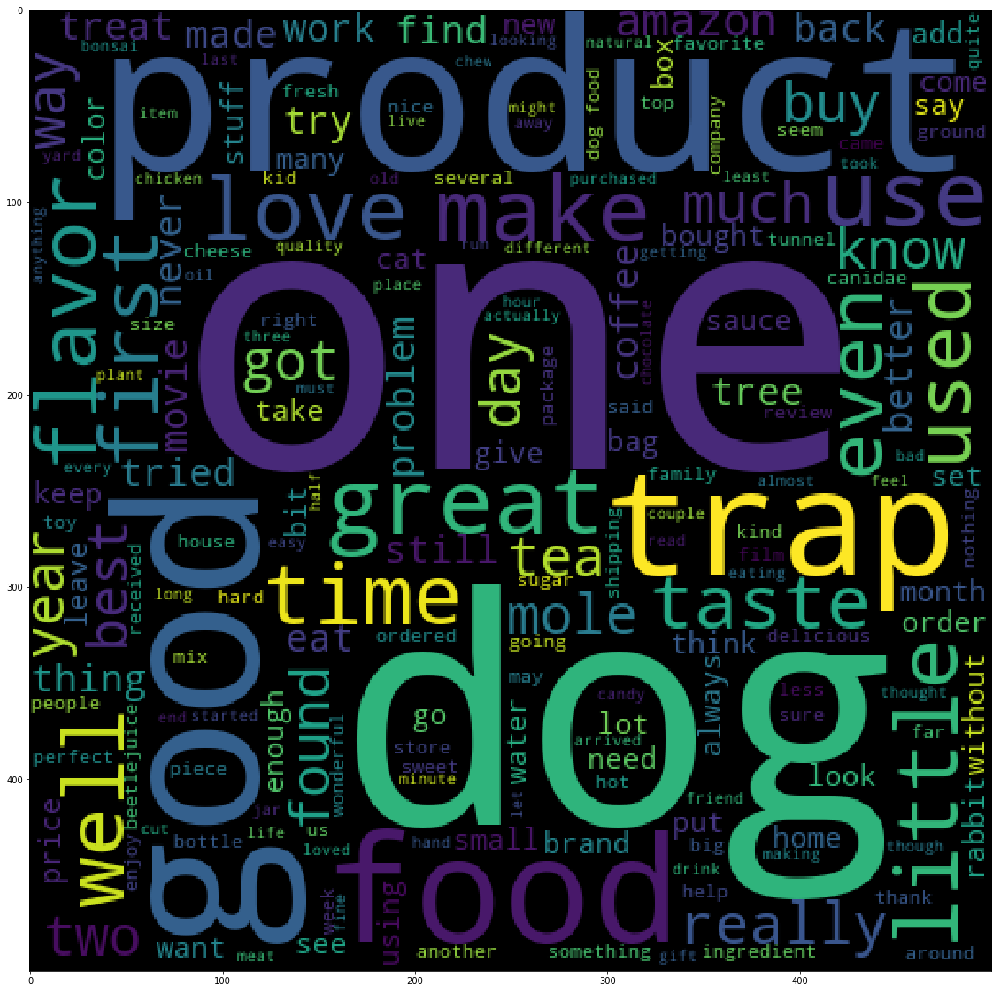

In [0]:
# Please write all the code with proper documentation
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])

words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

511351


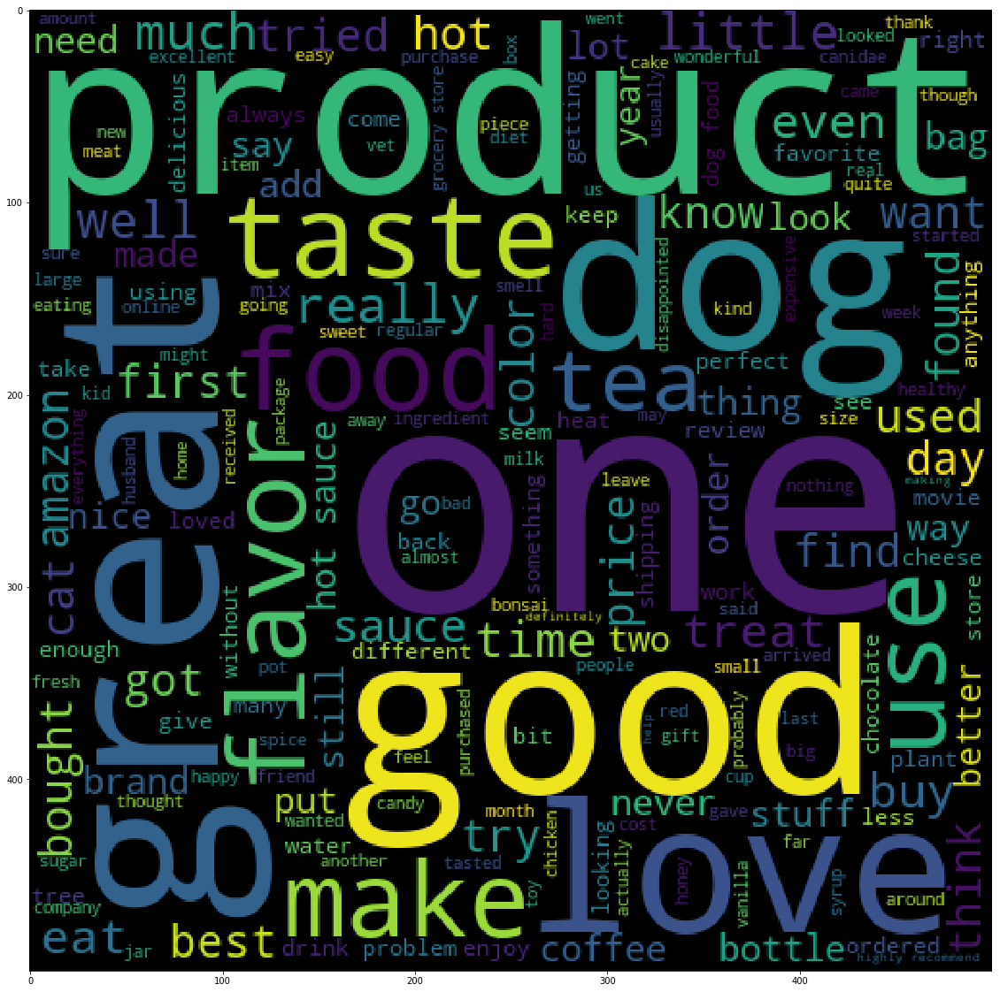

In [0]:
# Please write all the code with proper documentation
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])

words_2 = ''
for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '

print(len(words_2))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_2))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

87425


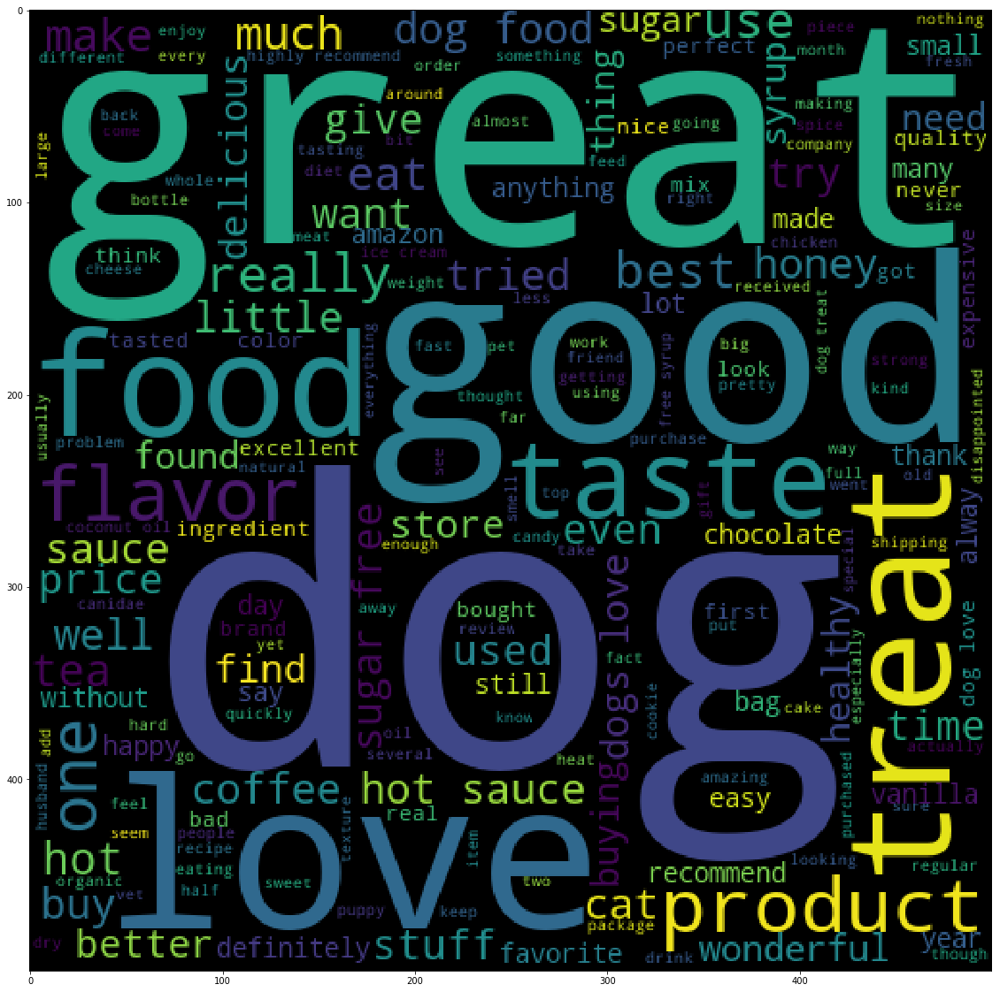

In [0]:
# Please write all the code with proper documentation
text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])

words_4 = ''
for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '

print(len(words_4))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_4))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

59502


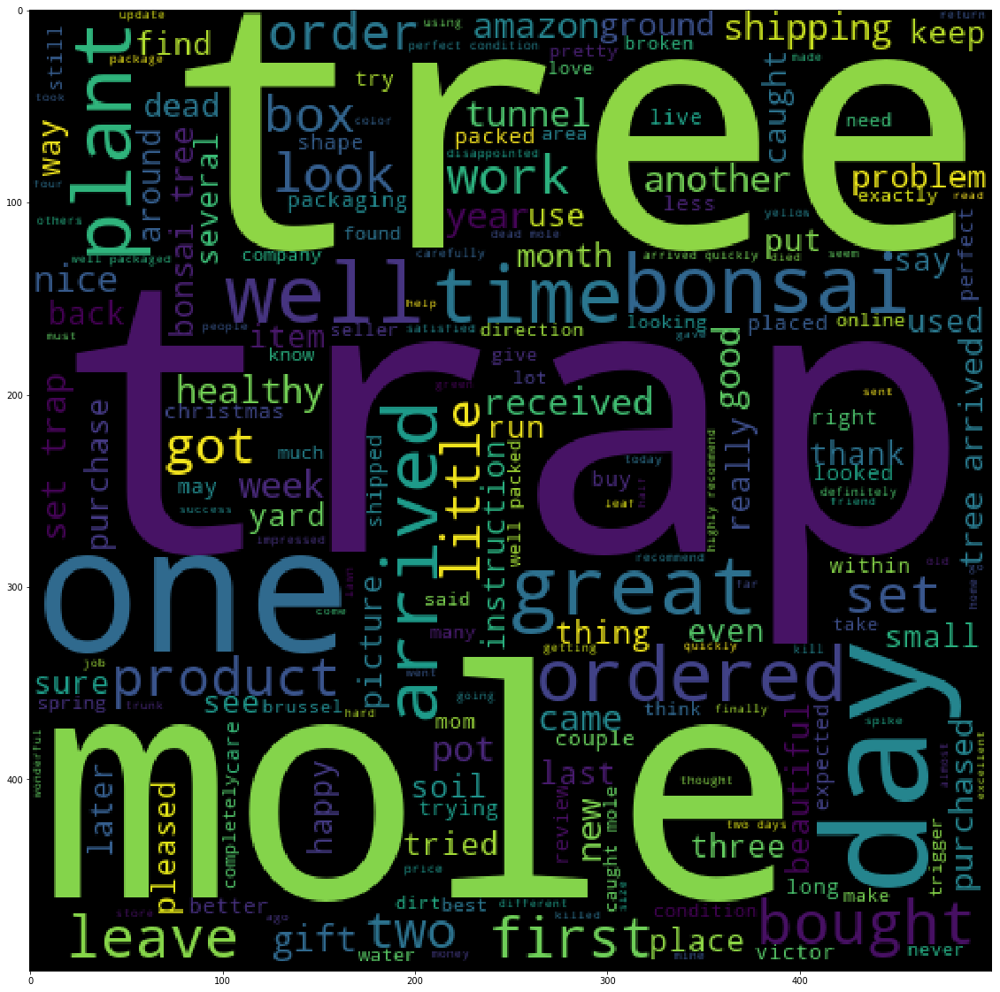

In [0]:
# Please write all the code with proper documentation
text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])

words_5 = ''
for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '

print(len(words_5))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_5))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

### [5.2.3] Applying Agglomerative Clustering on TFIDF W2V,<font color='red'> SET 4</font>

In [0]:
# Please write all the code with proper documentation

# Please write all the code with proper documentation
acc_tfidfw2v_2 = AgglomerativeClustering(n_clusters = 2)
acc_tfidfw2v_2_pred = acc_w2v_2.fit_predict(tfidf_sent_vectors)

In [0]:
index_1 = []
index_2 = []

for i in range(len(acc_tfidfw2v_2_pred)):
    if acc_tfidfw2v_2_pred[i] == 0:
        index_1.append(i)
    if acc_tfidfw2v_2_pred[i] == 1:
        index_2.append(i)

### Wordclouds of clusters obtained after applying Agglomerative Clustering on TFIDF W2V<font color='red'> SET 4</font>

846842


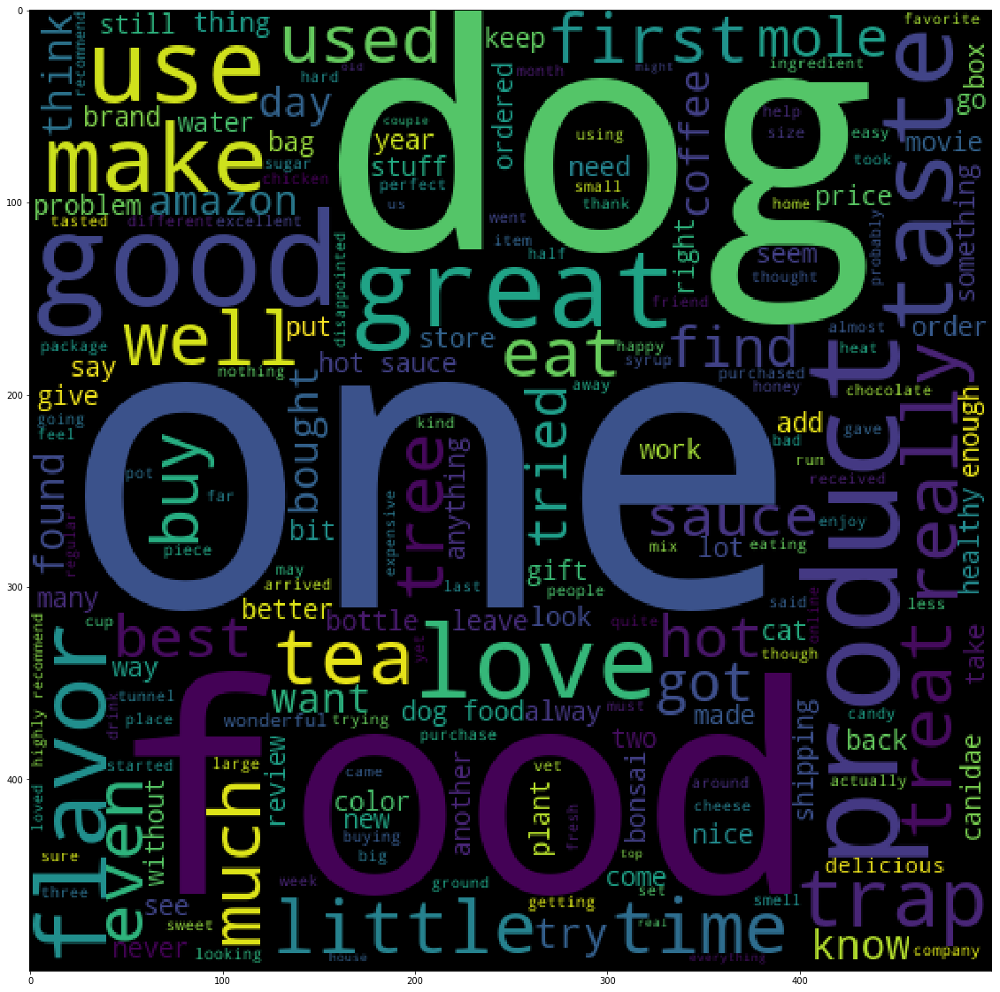

In [0]:
# Please write all the code with proper documentation
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])

words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

531209


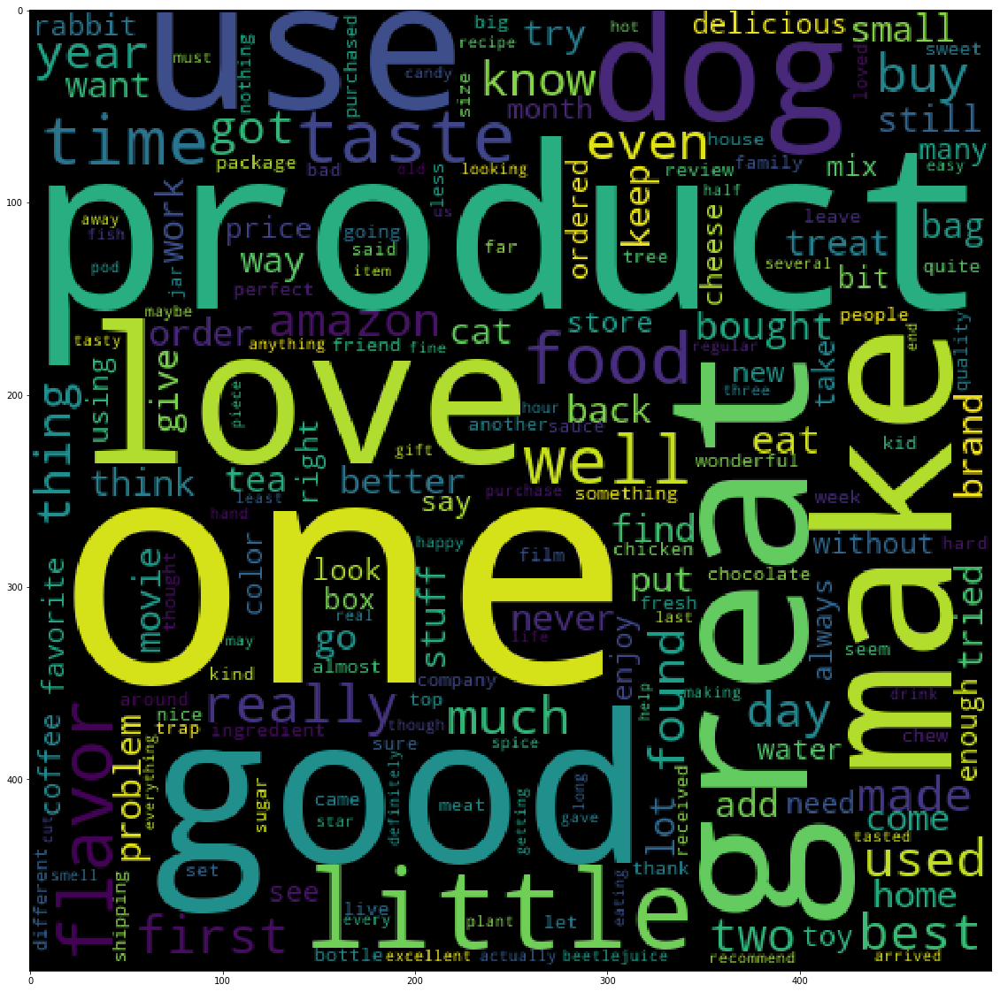

In [0]:
# Please write all the code with proper documentation
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])

words_2 = ''
for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '

print(len(words_2))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_2))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

In [0]:
#let take n_clusters = 5
acc_tfidfw2v_5 = AgglomerativeClustering(n_clusters = 5)
acc_tfidfw2v_5_pred = acc_tfidfw2v_5.fit_predict(tfidf_sent_vectors)

In [0]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
for i in range(len(acc_tfidfw2v_5_pred)):
    if acc_tfidfw2v_5_pred[i] == 0:
        index_1.append(i)
    if acc_tfidfw2v_5_pred[i] == 1:
        index_2.append(i)
    if acc_tfidfw2v_5_pred[i] == 2:
        index_3.append(i)
    if acc_tfidfw2v_5_pred[i] == 3:
        index_4.append(i)
    if acc_tfidfw2v_5_pred[i] == 4:
        index_5.append(i)

### Wordclouds of clusters obtained after applying Agglomerative Clustering on TFIDF W2V<font color='red'> SET 4</font>

233059


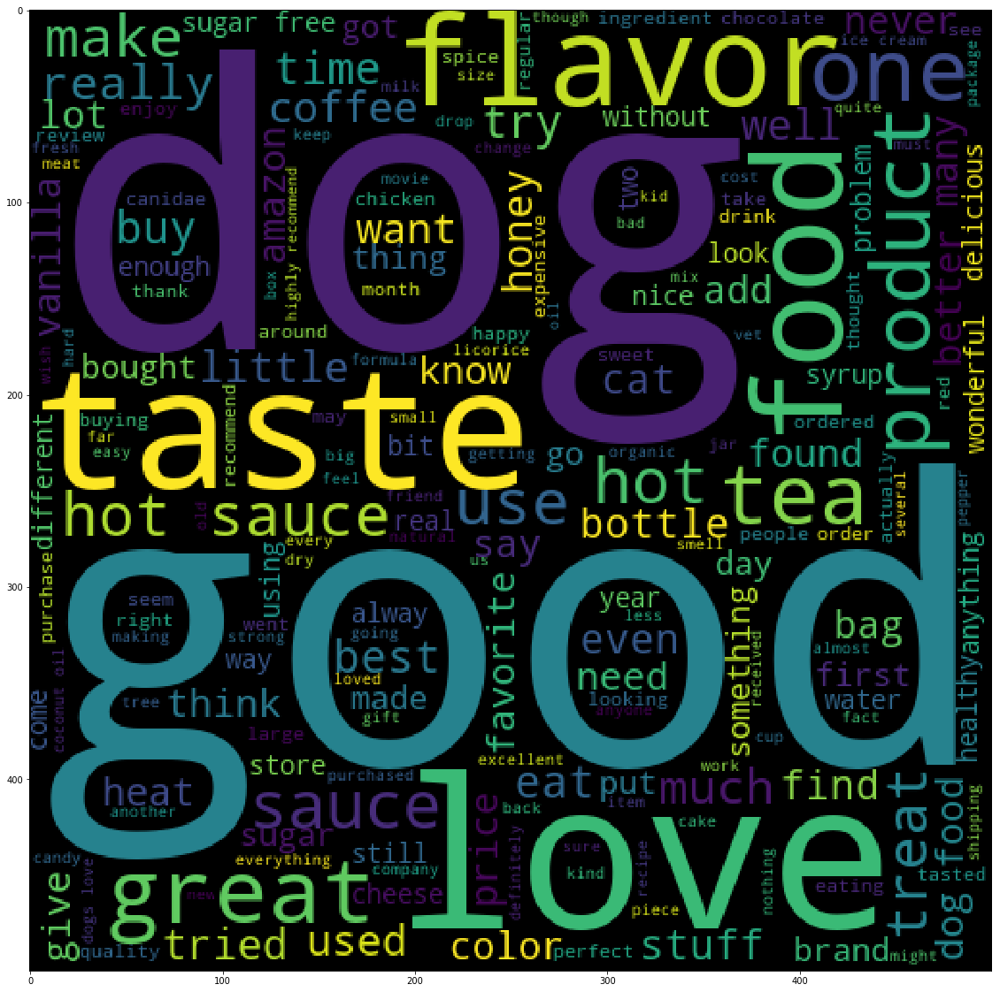

In [0]:
# Please write all the code with proper documentation
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

243172


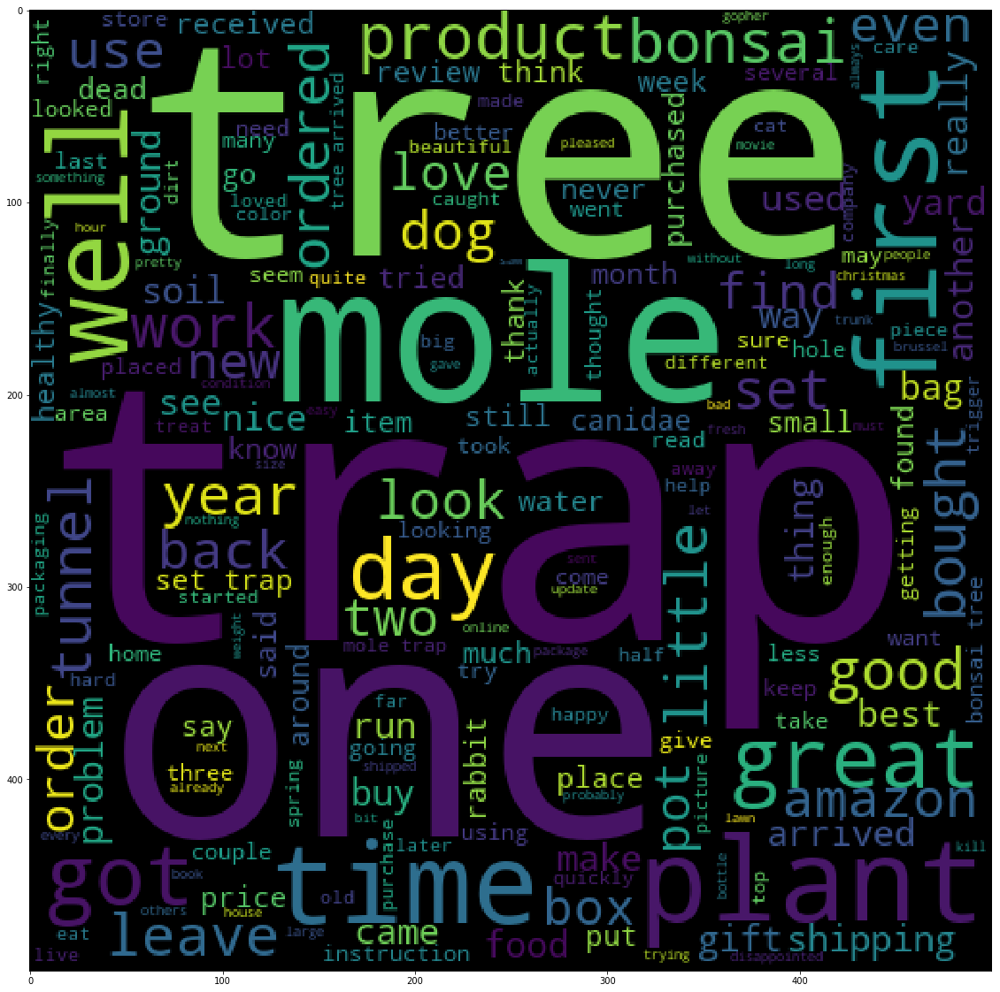

In [0]:
# Please write all the code with proper documentation
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])

words_2 = ''
for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '

print(len(words_2))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_2))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

75335


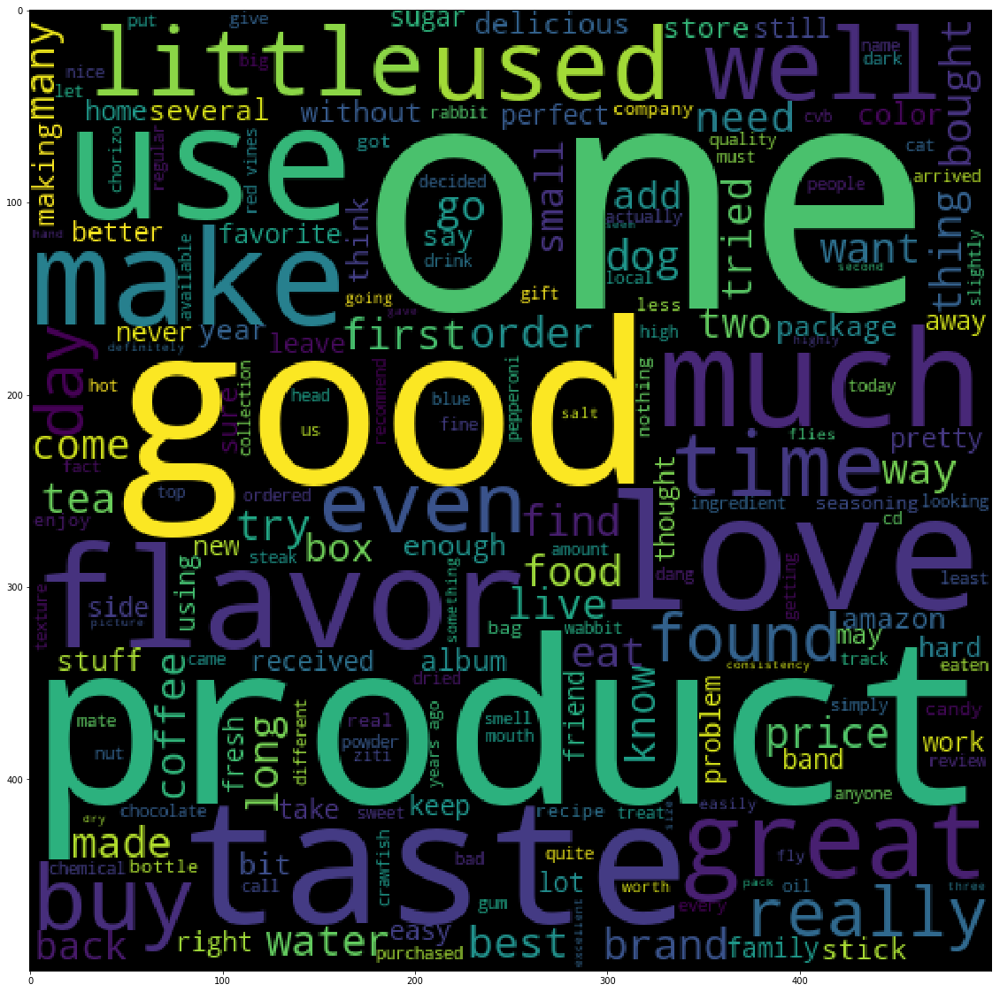

In [0]:
# Please write all the code with proper documentation
text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])

words_3 = ''
for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '

print(len(words_3))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_3))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

370611


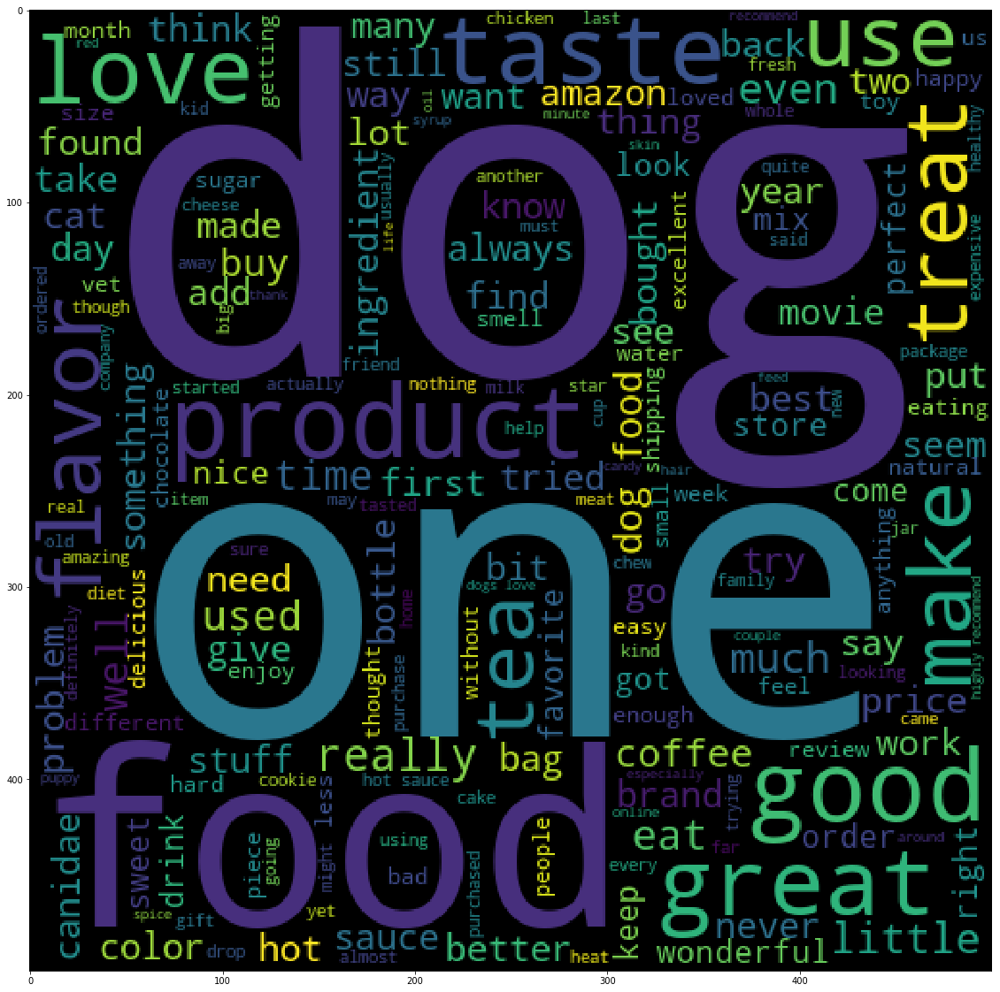

In [0]:
# Please write all the code with proper documentation
text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])

words_4 = ''
for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '

print(len(words_4))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_4))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

455874


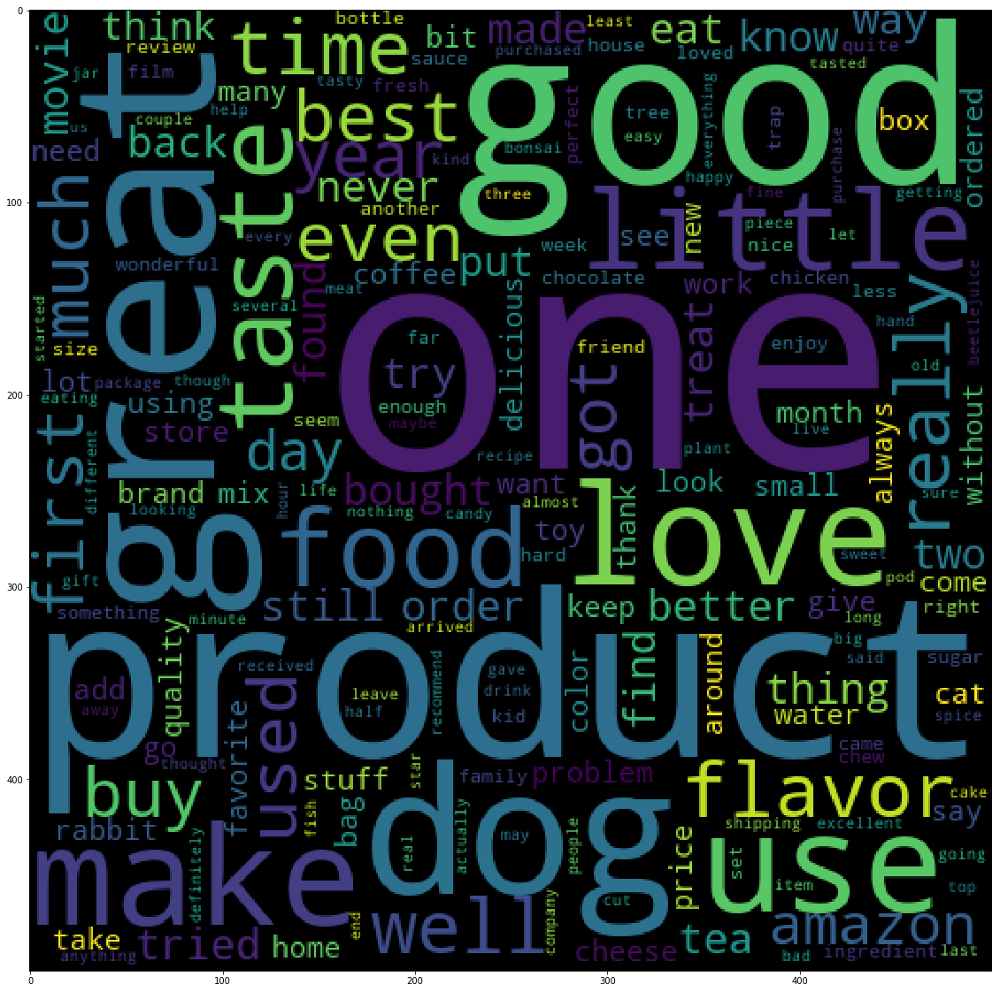

In [0]:
# Please write all the code with proper documentation
text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])

words_5 = ''
for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '

print(len(words_5))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_5))

fig = plt.figure(figsize = (30,20))
plt.imshow(wordcloud)

##  DBSCAN Clustering

In [34]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
w2v = sc.fit_transform(sent_vectors)

In [35]:
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors

min_point = 100
knn = NearestNeighbors(n_neighbors = min_point)

knn.fit(w2v)
dist , index = knn.kneighbors(w2v)

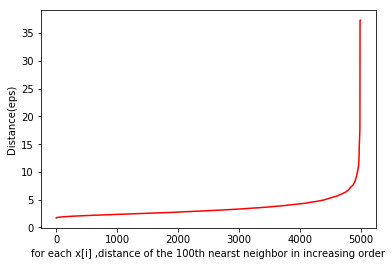

In [36]:
sort = sorted(dist[:,min_point-1])

plt.plot(list(range(1,len(w2v)+1)),sort  ,'r-')
plt.xlabel('for each x[i] ,distance of the 100th nearst neighbor in increasing order')
plt.ylabel('Distance(eps)')
plt.show()

### [5.3.1] Applying DBSCAN on AVG W2V,<font color='red'> SET 3</font>

In [56]:
# Please write all the code with proper documentation

db_w2v_8 = DBSCAN(eps = 8)
db_w2v_pred_8 = db_w2v_8.fit_predict(w2v)

In [57]:
n_clusters_ = len(set(db_w2v_pred_8)) - (1 if -1 in db_w2v_pred_8 else 0)
print ("No. of clusters formed = ",n_clusters_)
#https://github.com/abhishek-km23/Amazon-fine-food-review-analysis/blob/master/Amazon-fine-food-review%20-%20K-Means%2C%20Agglomerative%20%26%20DBSCAN%20Clustering.ipynb

No. of clusters formed =  2


In [58]:
index_1 = []
index_2 = []
for i in range(len(db_w2v_pred_8)):
    if db_w2v_pred_8[i] == 0:
        index_1.append(i)
    if db_w2v_pred_8[i] == 1:
        index_2.append(i)

###  Wordclouds of clusters obtained after applying DBSCAN on AVG W2V<font color='red'> SET 3</font>

1378039


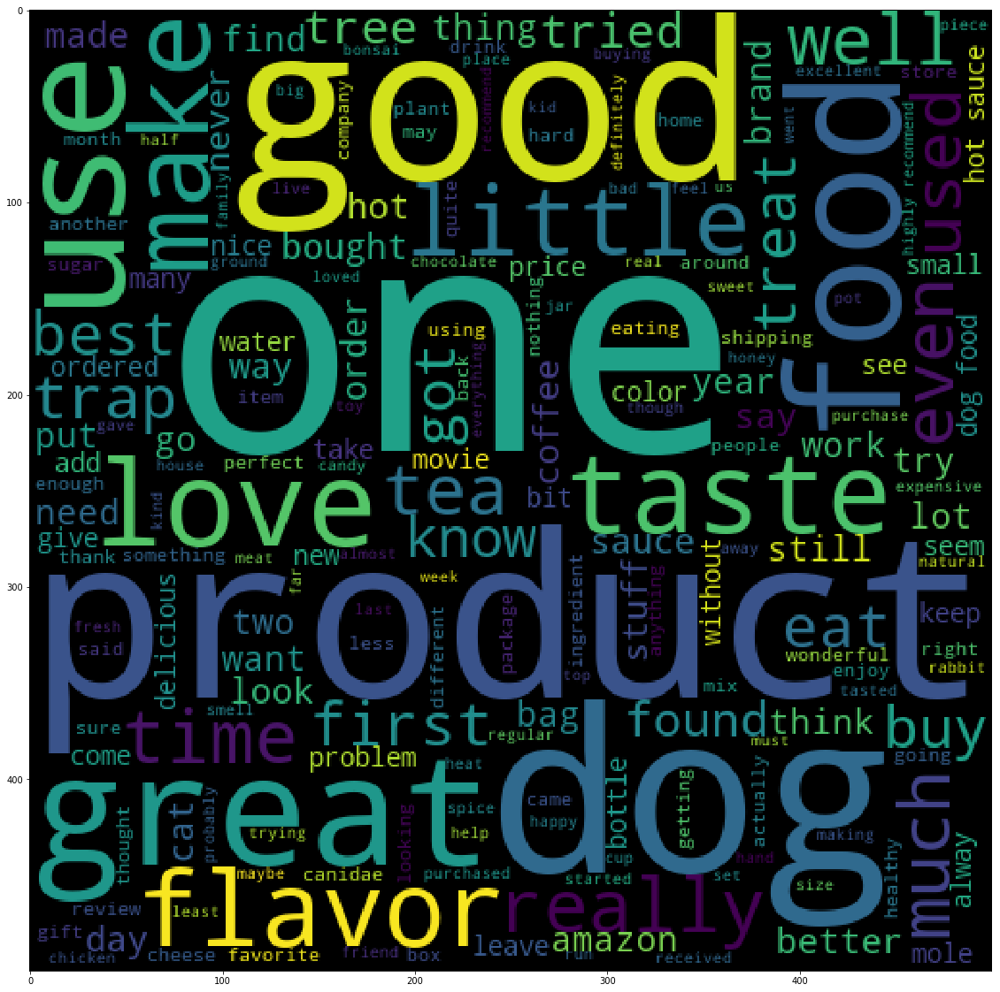

In [61]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

In [66]:
#lets take eps = 1

db_w2v_1 = DBSCAN(eps = 1)
db_w2v_1_pred = db_w2v_1.fit_predict(w2v)

In [67]:
n_clusters_ = len(set(db_w2v_1_pred)) - (1 if -1 in db_w2v_1_pred else 0)
print ("No. of clusters formed = ",n_clusters_)
#https://github.com/abhishek-km23/Amazon-fine-food-review-analysis/blob/master/Amazon-fine-food-review%20-%20K-Means%2C%20Agglomerative%20%26%20DBSCAN%20Clustering.ipynb

No. of clusters formed =  11


In [69]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []
index_6 = []
index_7 = []
index_8 = []
index_9 = []
index_10 = []
index_11 = []

for i in range(len(db_w2v_1_pred)):
    if db_w2v_1_pred[i] == 0:
        index_1.append(i)
    if db_w2v_1_pred[i] == 1:
        index_2.append(i)
    if db_w2v_1_pred[i] == 3:
        index_3.append(i)
    if db_w2v_1_pred[i] == 4:
        index_4.append(i)
    if db_w2v_1_pred[i] == 5:
        index_5.append(i)
    if db_w2v_1_pred[i] == 6:
        index_6.append(i)
    if db_w2v_1_pred[i] == 7:
        index_7.append(i)
    if db_w2v_1_pred[i] == 8:
        index_8.append(i)
    if db_w2v_1_pred[i] == 9:
        index_9.append(i)
    if db_w2v_1_pred[i] == 10:
        index_10.append(i)
    if db_w2v_1_pred[i] == 11:
        index_11.append(i)

### Wordclouds of clusters obtained after applying DBSCAN on AVG W2V<font color='red'> SET 3</font>

12695


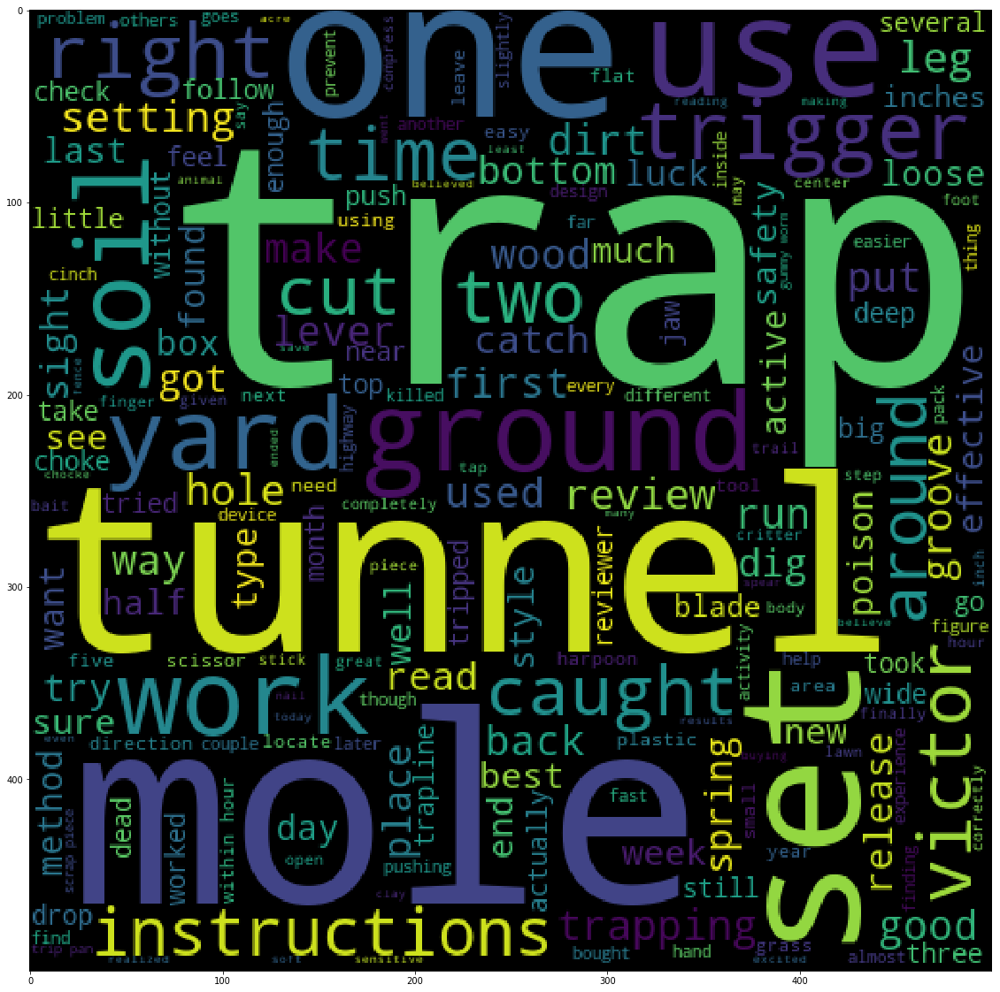

In [70]:
# Please write all the code with proper documentation
from wordcloud import WordCloud
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''
for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '

print(len(words_1))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_1))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

4853


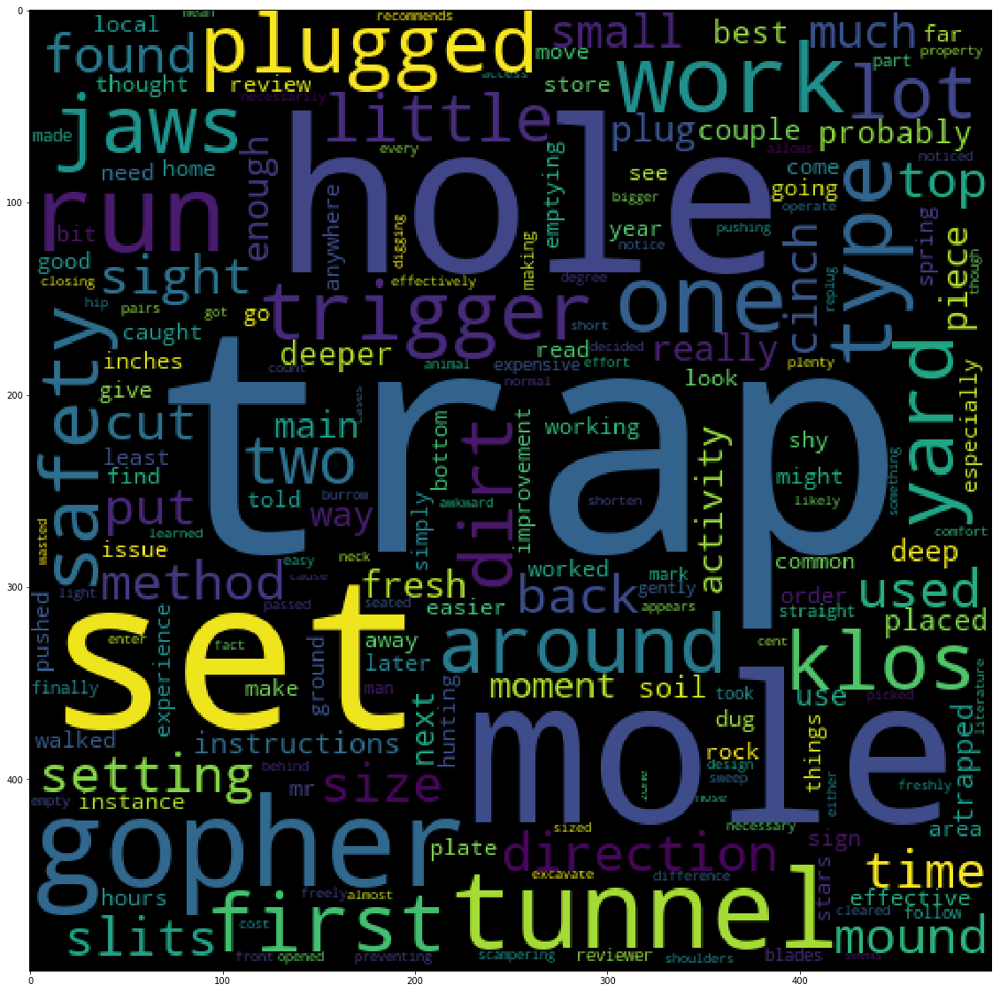

In [71]:
# Please write all the code with proper documentation

text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''
for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '

print(len(words_2))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_2))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

5275


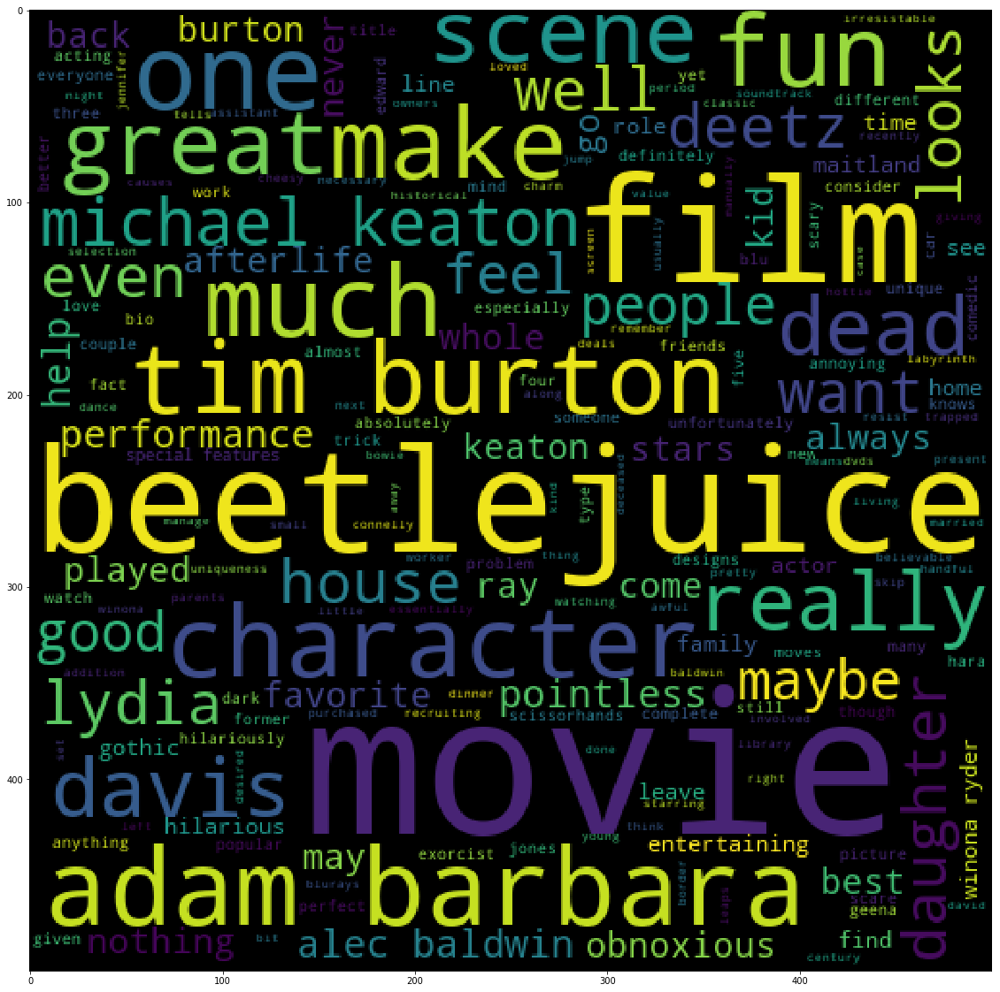

In [72]:
# Please write all the code with proper documentation

text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''
for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '

print(len(words_3))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_3))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

5819


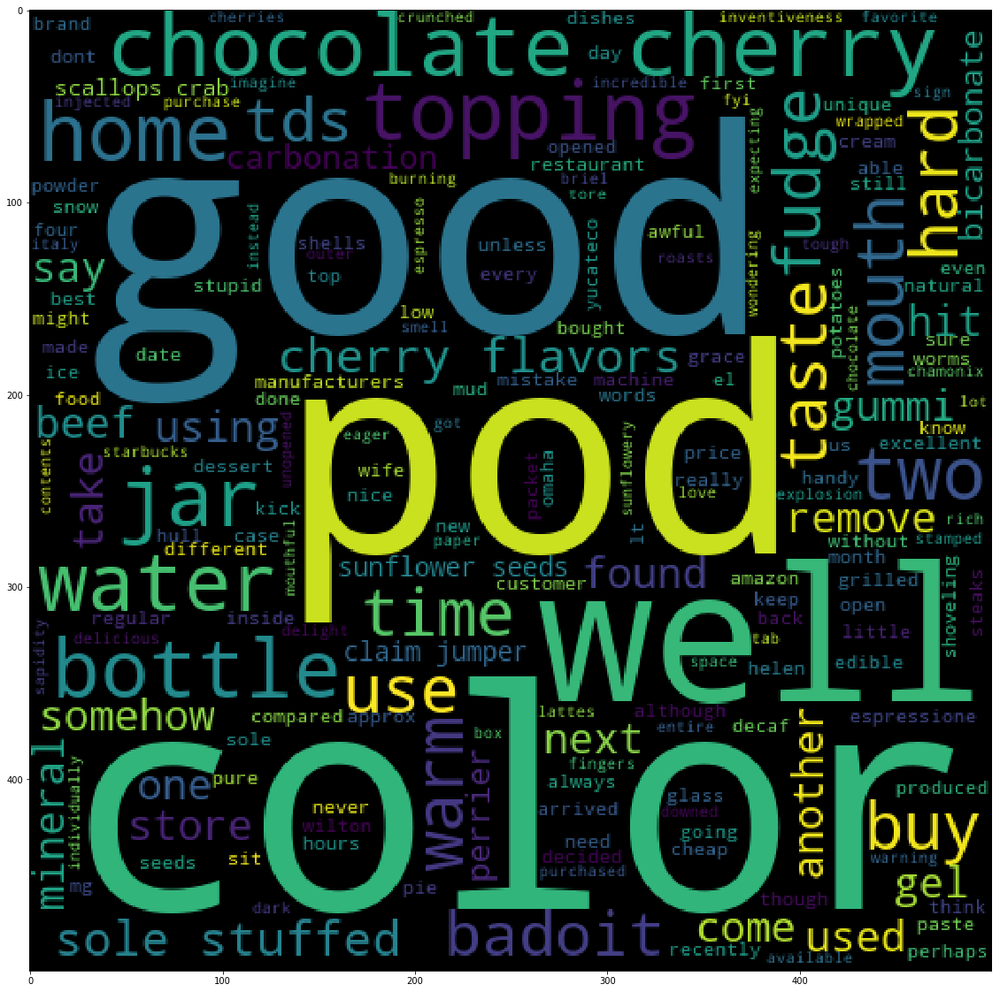

In [73]:
# Please write all the code with proper documentation

text_4 = []
for i in range(len(index_4)):
    text_4.append(list_of_sentance[index_4[i]])
    
words_4 = ''
for i in range(len(text_4)):
    for j in range(len(text_4[i])):
        words_4 = words_4 + text_4[i][j] + ' '

print(len(words_4))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_4))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

6916


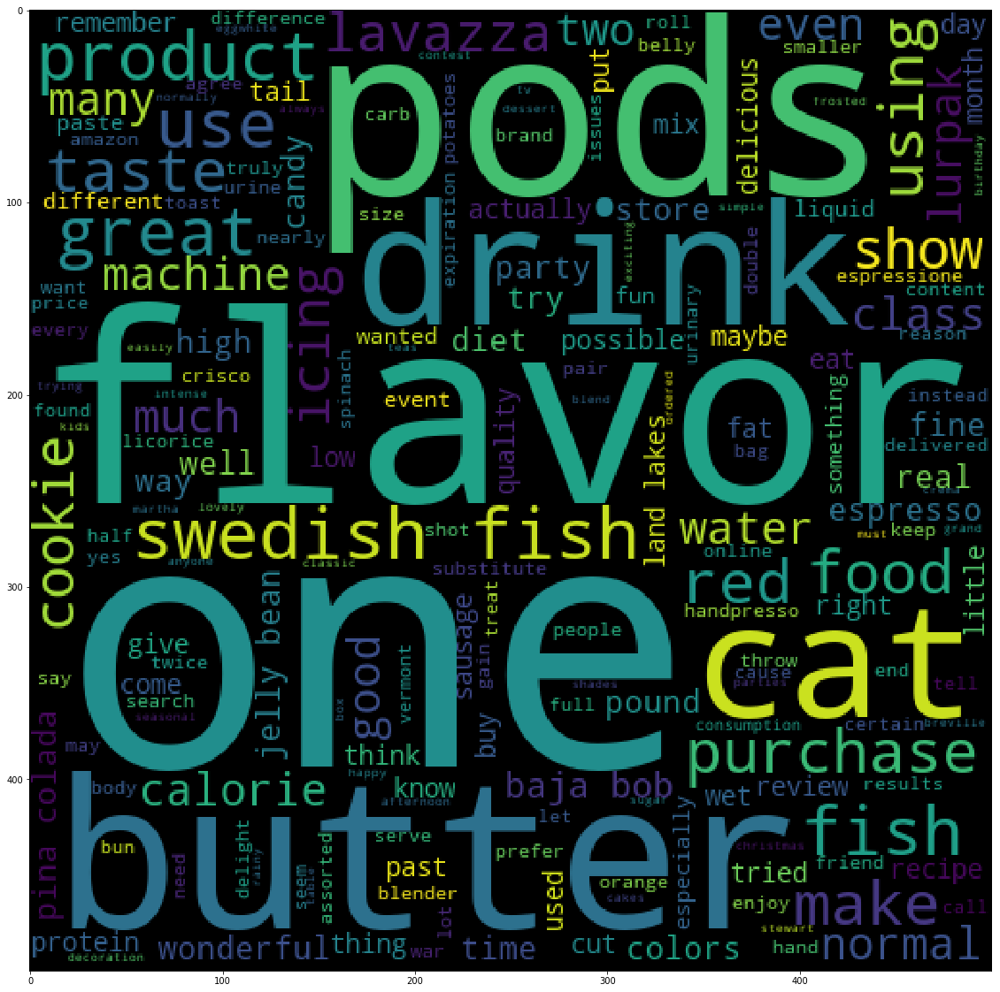

In [74]:
# Please write all the code with proper documentation

text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])
    
words_5 = ''
for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '

print(len(words_5))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_5))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

4598


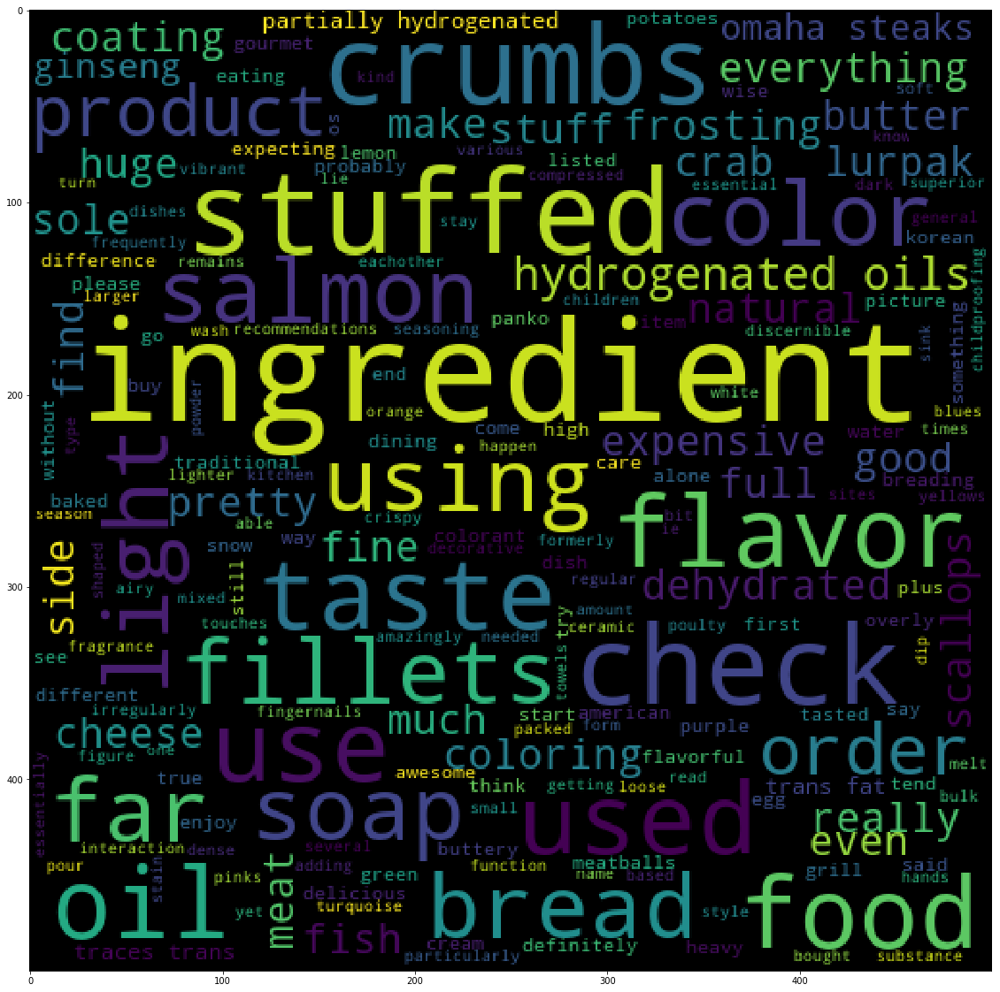

In [75]:
# Please write all the code with proper documentation

text_6 = []
for i in range(len(index_6)):
    text_6.append(list_of_sentance[index_6[i]])
    
words_6 = ''
for i in range(len(text_6)):
    for j in range(len(text_6[i])):
        words_6 = words_6 + text_6[i][j] + ' '

print(len(words_6))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_6))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

5327


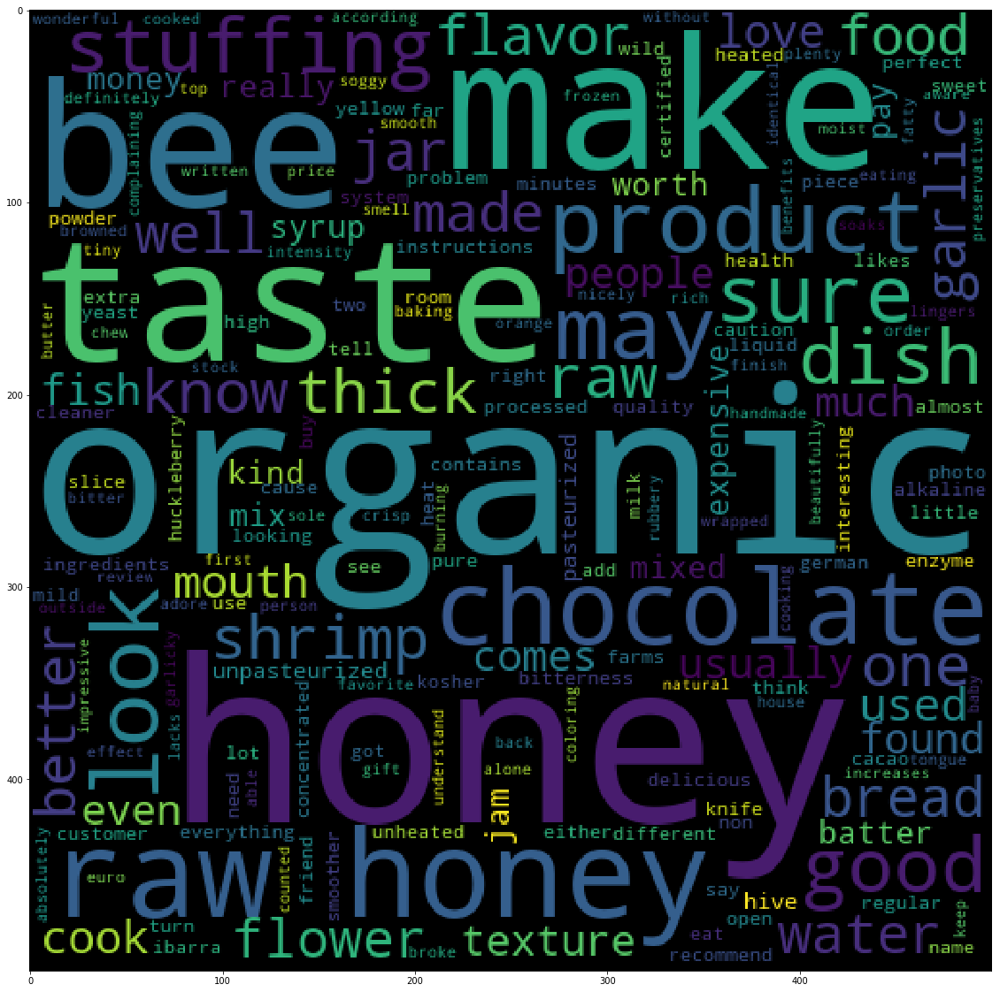

In [76]:
# Please write all the code with proper documentation

text_7 = []
for i in range(len(index_7)):
    text_7.append(list_of_sentance[index_7[i]])
    
words_7 = ''
for i in range(len(text_7)):
    for j in range(len(text_7[i])):
        words_7 = words_7 + text_7[i][j] + ' '

print(len(words_7))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_7))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

5505


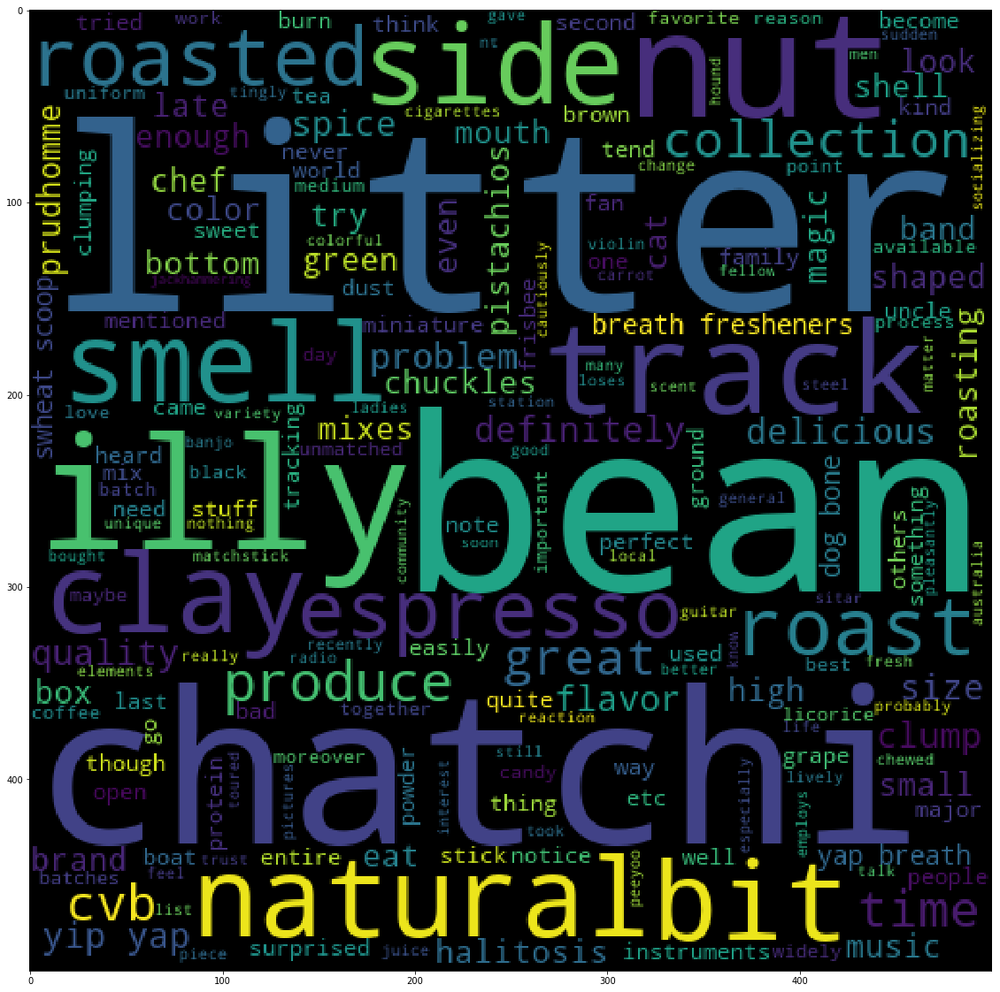

In [77]:
# Please write all the code with proper documentation

text_8 = []
for i in range(len(index_8)):
    text_8.append(list_of_sentance[index_8[i]])
    
words_8 = ''
for i in range(len(text_8)):
    for j in range(len(text_8[i])):
        words_8 = words_8 + text_8[i][j] + ' '

print(len(words_8))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_8))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

3023


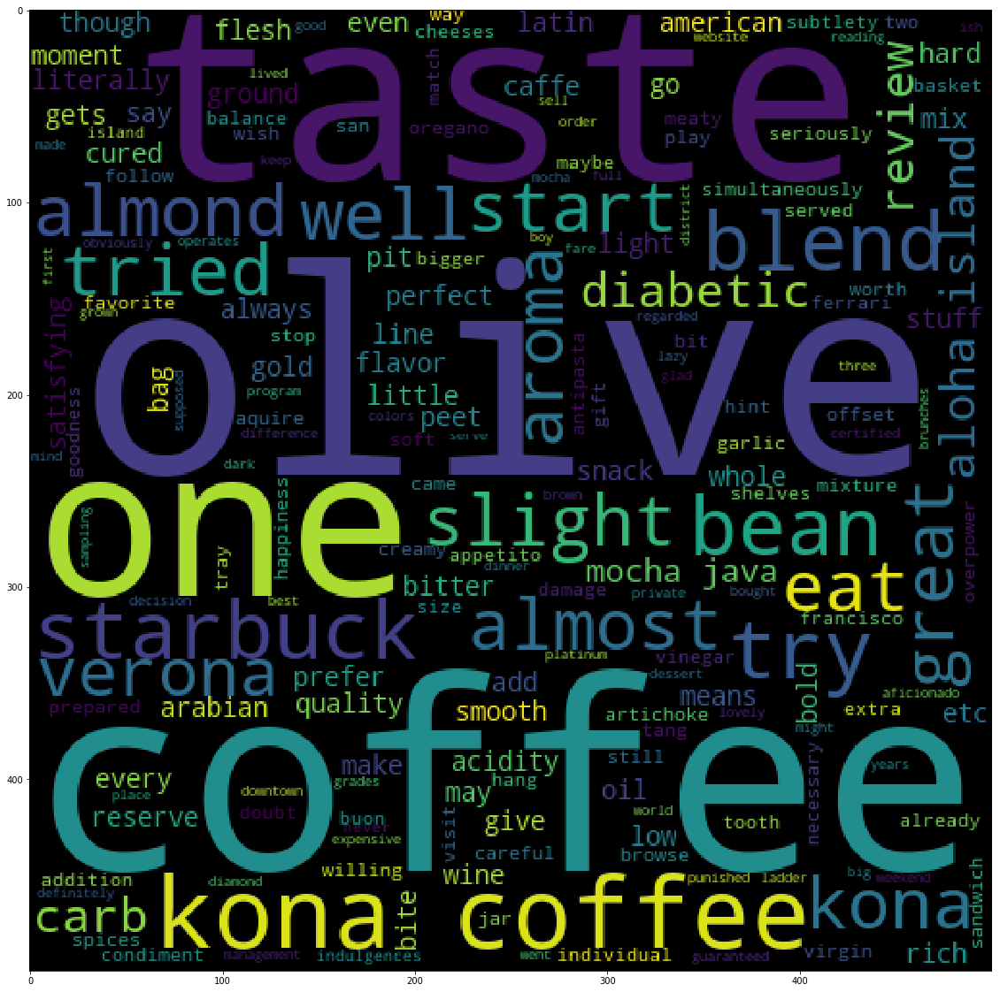

In [78]:
# Please write all the code with proper documentation

text_9 = []
for i in range(len(index_9)):
    text_9.append(list_of_sentance[index_9[i]])
    
words_9 = ''
for i in range(len(text_9)):
    for j in range(len(text_9[i])):
        words_9 = words_9 + text_9[i][j] + ' '

print(len(words_9))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_9))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

7375


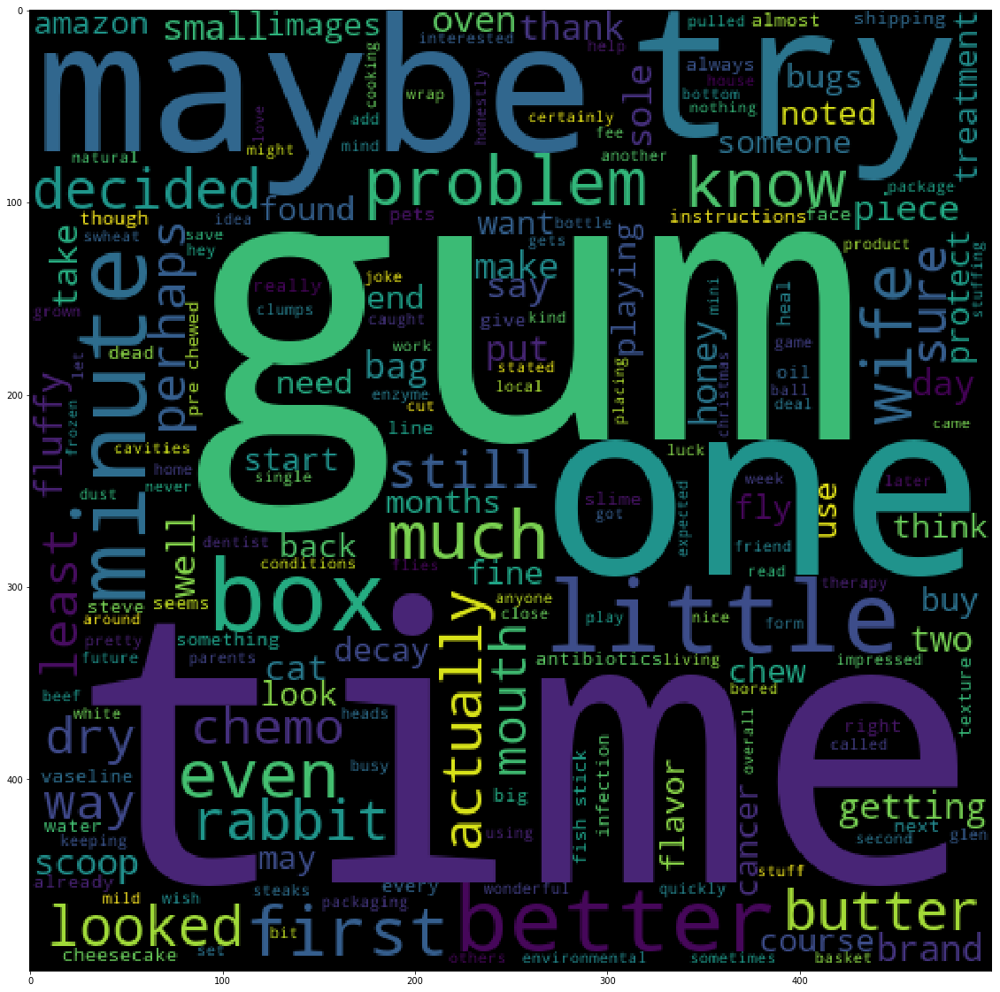

In [79]:
# Please write all the code with proper documentation

text_10 = []
for i in range(len(index_10)):
    text_10.append(list_of_sentance[index_10[i]])
    
words_10 = ''
for i in range(len(text_10)):
    for j in range(len(text_10[i])):
        words_10 = words_10 + text_10[i][j] + ' '

print(len(words_10))

wordcloud = WordCloud(background_color = 'black',
                     width = 500,
                     height = 500,
                     ).generate(str(words_10))

fig = plt.figure(figsize = (20,20))
plt.imshow(wordcloud)

### [5.3.3] Applying DBSCAN on TFIDF W2V,<font color='red'> SET 4</font>

In [91]:
# Please write all the code with proper documentation
#taking eps value = 5
db_tfidfw2v = DBSCAN(eps = 5)

db_tfidfw2v_pred = db_tfidfw2v.fit_predict(tfidf_sent_vectors)

In [92]:
set(db_tfidfw2v_pred)

{0}

In [93]:
index_1 = []

for i in range(len(db_tfidfw2v_pred)):
    if db_tfidfw2v_pred[i] == 0:
        index_1.append(i)

###  Wordclouds of clusters obtained after applying DBSCAN on TFIDF W2V<font color='red'> SET 4</font>

5000


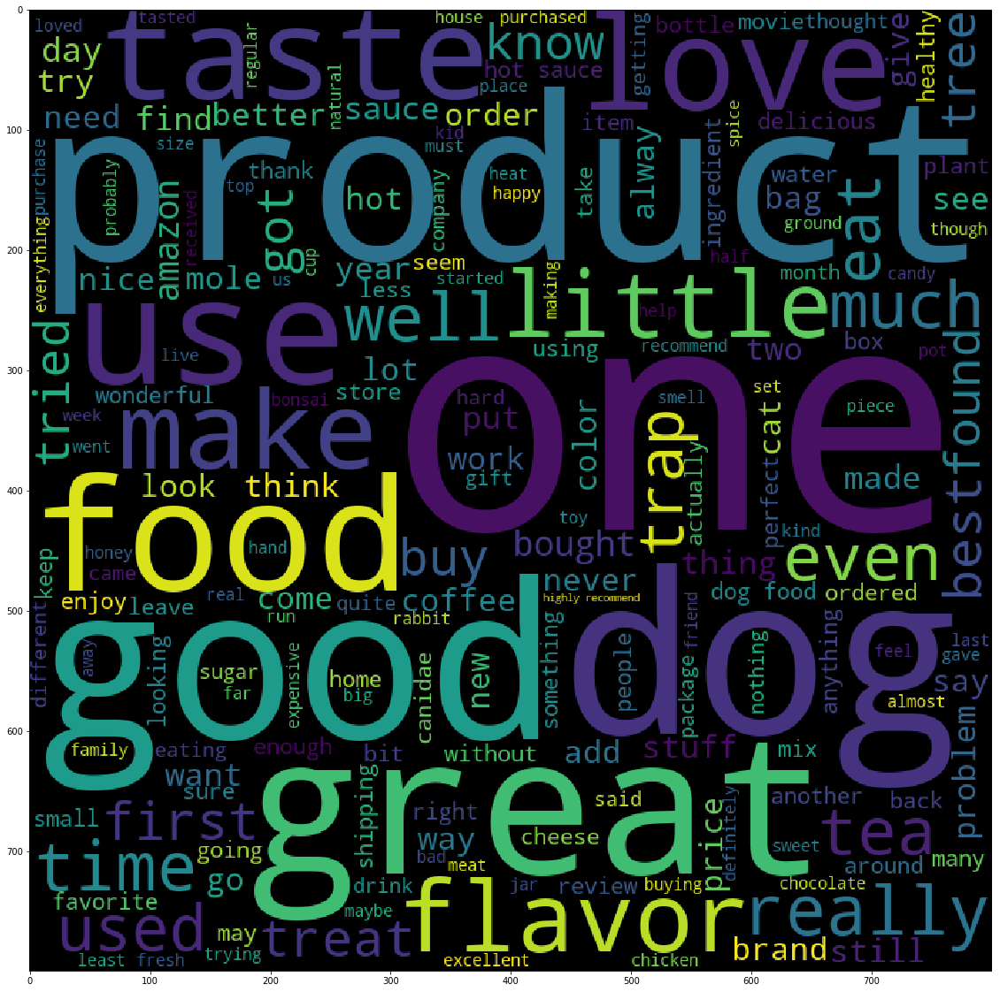

In [97]:
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '
        
print(len(text_1))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

In [105]:
#taking eps value = 0.1
db_tfidfw2v = DBSCAN(eps = .1)

db_tfidfw2v_pred = db_tfidfw2v.fit_predict(tfidf_sent_vectors)

In [107]:
n_clusters_ = len(set(db_tfidfw2v_pred)) - (1 if -1 in db_tfidfw2v_pred else 0)
print ("No. of clusters formed = ",n_clusters_)
#https://github.com/abhishek-km23/Amazon-fine-food-review-analysis/blob/master/Amazon-fine-food-review%20-%20K-Means%2C%20Agglomerative%20%26%20DBSCAN%20Clustering.ipynb

No. of clusters formed =  5


In [108]:
index_1 = []
index_2 = []
index_3 = []
index_4 = []
index_5 = []

for i in range(len(db_tfidfw2v_pred)):
    if db_tfidfw2v_pred[i] == 0:
        index_1.append(i)
    if db_tfidfw2v_pred[i] == 1:
        index_2.append(i)
    if db_tfidfw2v_pred[i] == 2:
        index_3.append(i)
    if db_tfidfw2v_pred[i] == 3:
        index_4.append(i)
    if db_tfidfw2v_pred[i] == 4:
        index_5.append(i)

###  Wordclouds of clusters obtained after applying DBSCAN on TFIDF W2V<font color='red'> SET 4</font>

4513


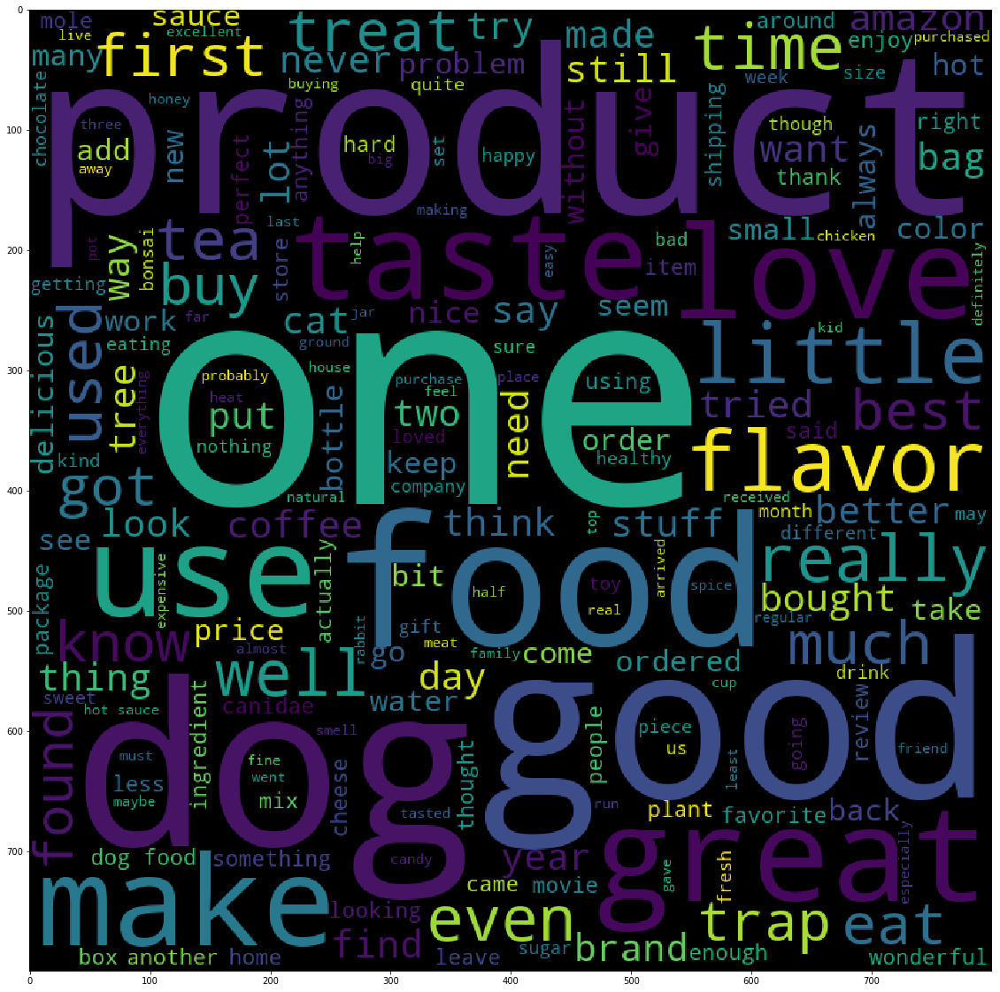

In [110]:
text_1 = []
for i in range(len(index_1)):
    text_1.append(list_of_sentance[index_1[i]])
    
words_1 = ''

for i in range(len(text_1)):
    for j in range(len(text_1[i])):
        words_1 = words_1 + text_1[i][j] + ' '
        
print(len(text_1))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_1))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

1082


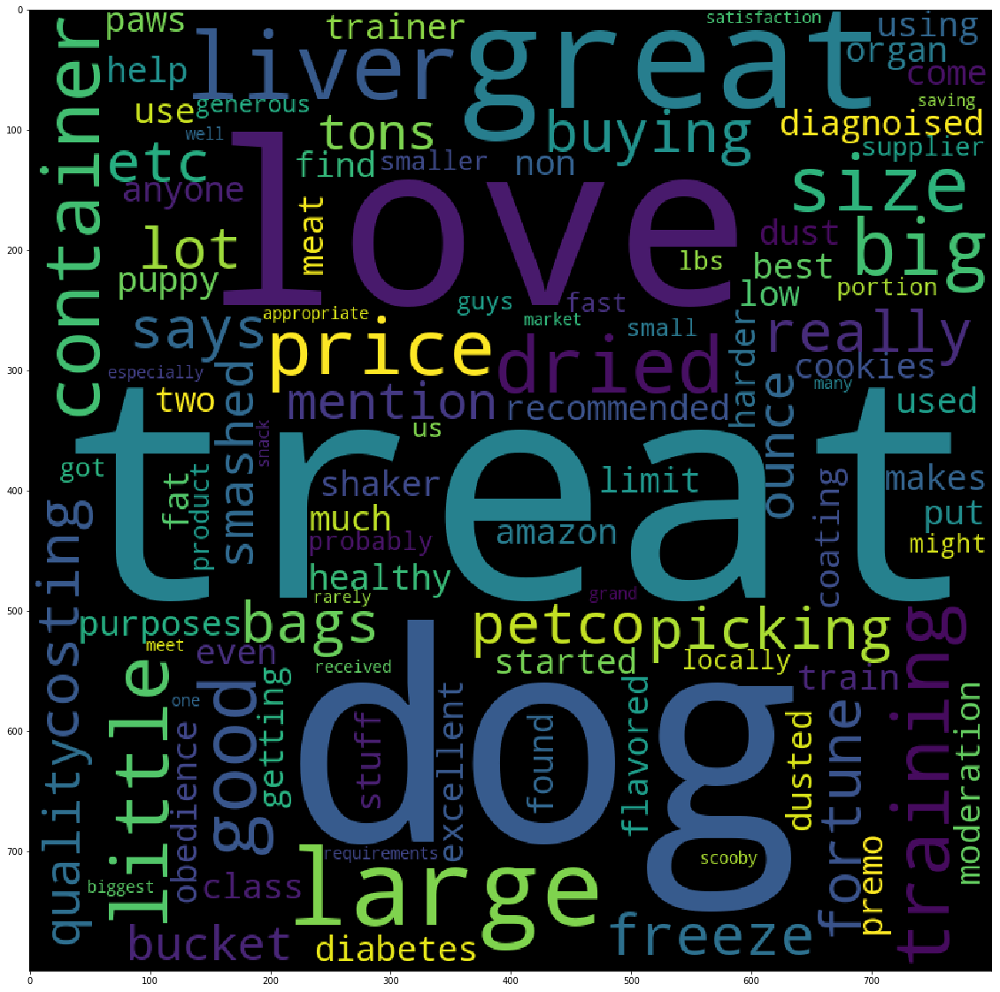

In [112]:
text_2 = []
for i in range(len(index_2)):
    text_2.append(list_of_sentance[index_2[i]])
    
words_2 = ''

for i in range(len(text_2)):
    for j in range(len(text_2[i])):
        words_2 = words_2 + text_2[i][j] + ' '
        
print(len(words_2))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_2))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

9763


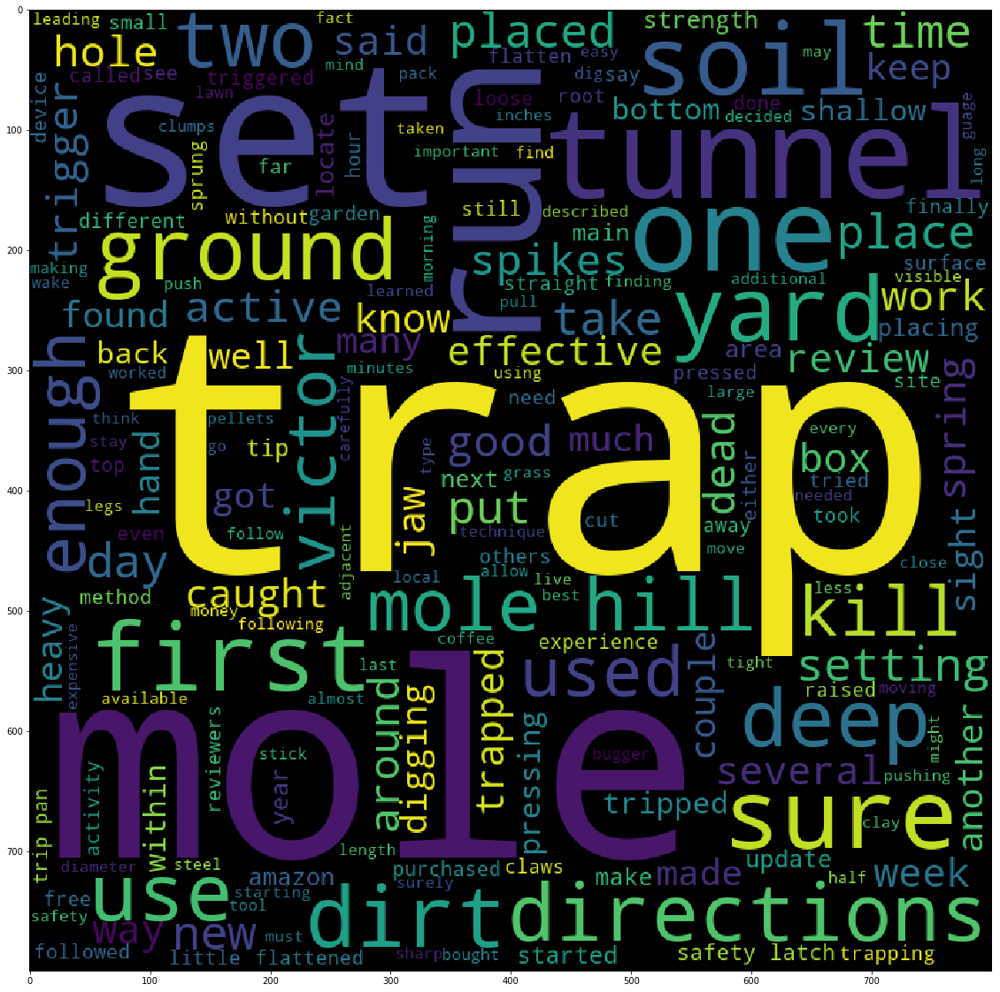

In [114]:
text_3 = []
for i in range(len(index_3)):
    text_3.append(list_of_sentance[index_3[i]])
    
words_3 = ''

for i in range(len(text_3)):
    for j in range(len(text_3[i])):
        words_3 = words_3 + text_3[i][j] + ' '
        
print(len(words_3))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_3))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

2147


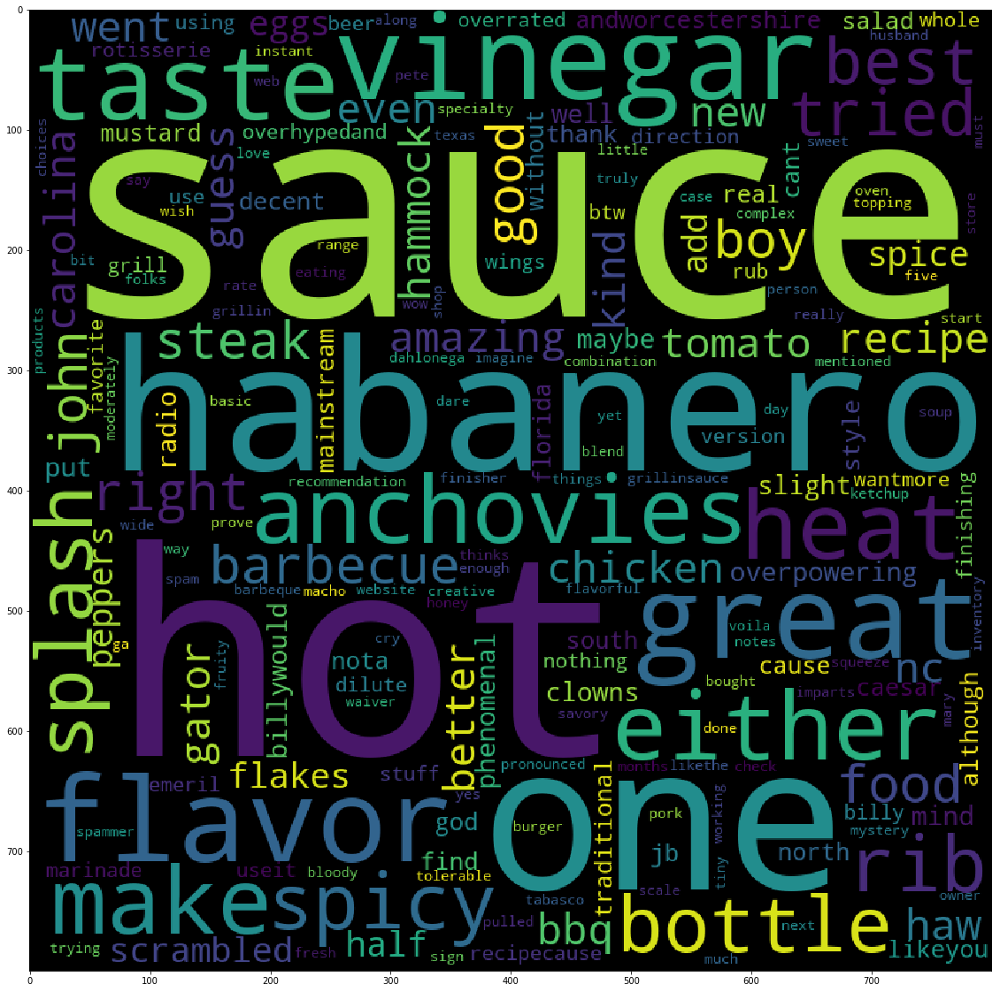

In [116]:
text_5 = []
for i in range(len(index_5)):
    text_5.append(list_of_sentance[index_5[i]])
    
words_5 = ''

for i in range(len(text_5)):
    for j in range(len(text_5[i])):
        words_5 = words_5 + text_5[i][j] + ' '
        
print(len(words_5))

wordcloud = WordCloud(    background_color='black',
                          width=800,
                          height=800,
                    ).generate(str(words_5))

fig = plt.figure(figsize=(30,20))
plt.imshow(wordcloud)

# [6] Conclusions

In [118]:
# Please compare all your models using Prettytable library. 
# You can have 3 tables, one each for kmeans, agllomerative and dbscan

from prettytable import PrettyTable
X=PrettyTable() 
print("KMeans On BOW ,TFIDF ,Avg W2V , TFIDF Weighted W2V")
X.field_names=["Model Name","Optimal Number Of Clusters"] 
X.add_row(["KMeans With BOW", 7]) 
X.add_row(["KMeans With TFIDF", 6])
X.add_row(["KMeans With Avg W2V", 6])
X.add_row(["KMeans With TFIDF Weighted W2V", 3]) 
print(X)

KMeans On BOW ,TFIDF ,Avg W2V , TFIDF Weighted W2V
+--------------------------------+----------------------------+
|           Model Name           | Optimal Number Of Clusters |
+--------------------------------+----------------------------+
|        KMeans With BOW         |             7              |
|       KMeans With TFIDF        |             6              |
|      KMeans With Avg W2V       |             6              |
| KMeans With TFIDF Weighted W2V |             3              |
+--------------------------------+----------------------------+


In [120]:
Y = PrettyTable()
print("Agglomerative clustering on Avg W2V , TFIDF Weighted W2V")
Y.field_names = ["Model Name" ,"No. of clusters taken"]
Y.add_row(["Agglomerative clustering with Avg W2V" , 2])
Y.add_row(["Agglomerative clustering with Avg W2V" , 5])
Y.add_row(["Agglomerative clustering with TFIDF Weighted W2V" , 2])
print(Y)

Agglomerative clustering on Avg W2V , TFIDF Weighted W2V
+--------------------------------------------------+-----------------------+
|                    Model Name                    | No. of clusters taken |
+--------------------------------------------------+-----------------------+
|      Agglomerative clustering with Avg W2V       |           2           |
|      Agglomerative clustering with Avg W2V       |           5           |
| Agglomerative clustering with TFIDF Weighted W2V |           2           |
+--------------------------------------------------+-----------------------+


In [123]:
Z = PrettyTable()
print("DBSCAN On Avg W2V ,TFIDF Weighted W2V")
Z.field_names = ["Model Name" ,"Value of epsilon taken" ,"No. of cluster formed"]
Z.add_row(["DBSCAN with Avg W2V" , 8, 2])
Z.add_row(["DBSCAN with Avg W2V" , 1 ,11])
Z.add_row(["DBSCAN with TFIDF Weighted W2V", 0.1 ,5])
Z.add_row(["DBSCAN with TFIDF Weighted W2V" , 5 ,1])
print(Z)

DBSCAN On Avg W2V ,TFIDF Weighted W2V
+--------------------------------+------------------------+-----------------------+
|           Model Name           | Value of epsilon taken | No. of cluster formed |
+--------------------------------+------------------------+-----------------------+
|      DBSCAN with Avg W2V       |           8            |           2           |
|      DBSCAN with Avg W2V       |           1            |           11          |
| DBSCAN with TFIDF Weighted W2V |          0.1           |           5           |
| DBSCAN with TFIDF Weighted W2V |           5            |           1           |
+--------------------------------+------------------------+-----------------------+
